In [1]:
print("ashish")
!pwd

ashish
/home/ashishr/my_project_github_check/Experiments_SNIP


In [2]:
import os
%cd ../Data
# Install required packages and download data if not already present
if not os.path.exists('open-images-bus-trucks'):
    !wget --quiet https://www.dropbox.com/s/agmzwk95v96ihic/open-images-bus-trucks.tar.xz
    !tar -xf open-images-bus-trucks.tar.xz
    !rm open-images-bus-trucks.tar.xz
%cd ../Experiments_SNIP

/home/ashishr/my_project_github_check/Data
/home/ashishr/my_project_github_check/Experiments_SNIP


In [3]:
# Move to the 'annotations' directory and copy annotation files
%cd ../Data/open-images-bus-trucks/annotations
!cp mini_open_images_train_coco_format.json instances_train2017.json
!cp mini_open_images_val_coco_format.json instances_val2017.json
%cd ../../../Experiments_SNIP

/home/ashishr/my_project_github_check/Data/open-images-bus-trucks/annotations
/home/ashishr/my_project_github_check/Experiments_SNIP


In [4]:
# Move back to the main directory
%cd ../Data/open-images-bus-trucks
# Create symbolic links for image directories
!ln -s images/ train2017
!ln -s images/ val2017
# Change to the 'detr' directory
%cd ../../Experiments_SNIP

/home/ashishr/my_project_github_check/Data/open-images-bus-trucks
/home/ashishr/my_project_github_check/Experiments_SNIP


In [5]:
# Define the classes for detection
CLASSES = ['', 'BUS','TRUCK']

In [6]:
pwd

'/home/ashishr/my_project_github_check/Experiments_SNIP'

In [13]:
# Import required libraries
from torch_snippets import *
# Check if the pretrained model is available, and if not, download it
if not os.path.exists('detr-r50-e632da11.pth'):
    !wget https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth
    checkpoint = torch.load("detr-r50-e632da11.pth", map_location='cpu')
    del checkpoint["model"]["class_embed.weight"]
    del checkpoint["model"]["class_embed.bias"]
    torch.save(checkpoint,"detr-r50_no-class-head.pth")

--2024-06-04 05:18:34--  https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 13.249.221.49, 13.249.221.58, 13.249.221.77, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|13.249.221.49|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 166618694 (159M) [application/octet-stream]
Saving to: ‘detr-r50-e632da11.pth’

detr-r50-e632da11.p 100%[===================>] 158.90M  53.0MB/s    in 3.0s    

2024-06-04 05:18:38 (53.0 MB/s) - ‘detr-r50-e632da11.pth’ saved [166618694/166618694]



# train without pruning

In [213]:
# Run the main script to train the model
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/prune_detr_FPGM_L1_L2.py --coco_path ../Data/open-images-bus-trucks/\
  --epochs 4 --lr=1e-4 --batch_size=2 --num_workers=4\
  --output_dir="output_detr_without_prune" --resume="detr-r50_no-class-head.pth"



*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 1): env://
| distributed init (rank 2): env://
| distributed init (rank 0): env://
mask Ready
mask Done
mask similar Done
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Start training
Module name: layer1.2.conv3.weight, Nonzero weights: 16384, Zero weights: 0
Module name: layer2.0.conv1.weight, Nonzero weights: 32768, Zero weights: 0
Module name: layer2.0.conv2.weight, Nonzero weights: 147456, Zero weights: 0
Module name: layer2.0.conv3.weight, Nonzero weights: 65536, Zero weights: 0
Module name: layer2.0.downsample.0.weight, Nonzero weights: 131072, Zero 

In [23]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/detr_prune_snip.py --coco_path ../Data/open-images-bus-trucks/  \
--epochs 10 --lr=1e-4 --batch_size=2 --num_workers=4  \
--output_dir="DETR_output_snip" --resume="detr-r50_no-class-head.pth" \
--compression 0.9 \
--prune \
--pruner snip



/home/iisc/anaconda3/lib/python3.9/site-packages/torch/distributed/launch.py:181: FutureWarning: The module torch.distributed.launch is deprecated
and will be removed in future. Use torchrun.
Note that --use-env is set by default in torchrun.
If your script expects `--local-rank` argument to be set, please
change it to read from `os.environ['LOCAL_RANK']` instead. See 
https://pytorch.org/docs/stable/distributed.html#launch-utility for 
further instructions

  warnings.warn(
[2024-06-03 13:54:14,313] torch.distributed.run: [WARNING] 
[2024-06-03 13:54:14,313] torch.distributed.run: [WARNING] *****************************************
[2024-06-03 13:54:14,313] torch.distributed.run: [WARNING] Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
[2024-06-03 13:54:14,313] torch.distributed.run: [WARNING] *******************************

  0%|                                                    | 0/10 [00:00<?, ?it/s]SNIP Scoring:  [ 0/68]  eta: 0:01:58    time: 1.7455  data: 0.2493  max mem: 2199
SNIP Scoring:  [10/68]  eta: 0:00:26    time: 0.4616  data: 0.0319  max mem: 3767
SNIP Scoring:  [20/68]  eta: 0:00:19    time: 0.3310  data: 0.0108  max mem: 3767
SNIP Scoring:  [30/68]  eta: 0:00:14    time: 0.3220  data: 0.0117  max mem: 3767
SNIP Scoring:  [40/68]  eta: 0:00:10    time: 0.3166  data: 0.0118  max mem: 3767
SNIP Scoring:  [50/68]  eta: 0:00:06    time: 0.2991  data: 0.0110  max mem: 3767
SNIP Scoring:  [60/68]  eta: 0:00:02    time: 0.2759  data: 0.0106  max mem: 3775
SNIP Scoring:  [67/68]  eta: 0:00:00    time: 0.2765  data: 0.0113  max mem: 3775
SNIP Scoring: Total time: 0:00:22 (0.3277 s / it)
0.8128305161640993
sparsity value
globalscore
torch.Size([36703168])
6869713
 10%|████▍                                       | 1/10 [00:22<03:24, 22.74s/it]SNIP Scoring:  [ 0/68]  eta: 0:00:39    time: 0.5828  dat

SNIP Scoring:  [50/68]  eta: 0:00:06    time: 0.3723  data: 0.0112  max mem: 5781
SNIP Scoring:  [60/68]  eta: 0:00:03    time: 0.3694  data: 0.0115  max mem: 5781
SNIP Scoring:  [67/68]  eta: 0:00:00    time: 0.3847  data: 0.0115  max mem: 5781
SNIP Scoring: Total time: 0:00:26 (0.3894 s / it)
0.15488166189124813
sparsity value
globalscore
torch.Size([36703168])
31018520
Epoch 9/10, Sparsity: 5684648.0/36703168 (0.1549)
 90%|███████████████████████████████████████▌    | 9/10 [03:47<00:26, 26.64s/it]SNIP Scoring:  [ 0/68]  eta: 0:01:22    time: 1.2136  data: 0.3786  max mem: 5781
SNIP Scoring:  [10/68]  eta: 0:00:26    time: 0.4512  data: 0.0433  max mem: 5781
SNIP Scoring:  [20/68]  eta: 0:00:19    time: 0.3755  data: 0.0101  max mem: 5781
SNIP Scoring:  [30/68]  eta: 0:00:15    time: 0.3771  data: 0.0106  max mem: 5781
SNIP Scoring:  [40/68]  eta: 0:00:11    time: 0.3991  data: 0.0113  max mem: 5781
SNIP Scoring:  [50/68]  eta: 0:00:07    time: 0.4008  data: 0.0122  max mem: 5781
SNI

100%|███████████████████████████████████████████| 10/10 [04:15<00:00, 25.52s/it]
Epoch: [0]  [ 0/68]  eta: 0:01:40  lr: 0.000100  class_error: 50.00  loss: 22.5066 (22.5066)  loss_bbox: 2.7099 (2.7099)  loss_bbox_0: 1.5225 (1.5225)  loss_bbox_1: 1.4258 (1.4258)  loss_bbox_2: 1.4970 (1.4970)  loss_bbox_3: 1.7945 (1.7945)  loss_bbox_4: 1.8395 (1.8395)  loss_ce: 1.2275 (1.2275)  loss_ce_0: 1.1369 (1.1369)  loss_ce_1: 1.0805 (1.0805)  loss_ce_2: 1.0761 (1.0761)  loss_ce_3: 1.1745 (1.1745)  loss_ce_4: 1.2322 (1.2322)  loss_giou: 1.0267 (1.0267)  loss_giou_0: 0.5979 (0.5979)  loss_giou_1: 0.6743 (0.6743)  loss_giou_2: 0.7418 (0.7418)  loss_giou_3: 0.8974 (0.8974)  loss_giou_4: 0.8515 (0.8515)  cardinality_error_unscaled: 83.3333 (83.3333)  cardinality_error_0_unscaled: 64.6667 (64.6667)  cardinality_error_1_unscaled: 54.3333 (54.3333)  cardinality_error_2_unscaled: 55.0000 (55.0000)  cardinality_error_3_unscaled: 70.6667 (70.6667)  cardinality_error_4_unscaled: 76.8333 (76.8333)  class_error

Epoch: [0]  [50/68]  eta: 0:00:08  lr: 0.000100  class_error: 100.00  loss: 12.0890 (15.6079)  loss_bbox: 1.0211 (1.3193)  loss_bbox_0: 1.0250 (1.2247)  loss_bbox_1: 0.9268 (1.2035)  loss_bbox_2: 0.9202 (1.1904)  loss_bbox_3: 0.9362 (1.1934)  loss_bbox_4: 1.0214 (1.2263)  loss_ce: 0.4668 (0.5422)  loss_ce_0: 0.4840 (0.5643)  loss_ce_1: 0.4839 (0.5400)  loss_ce_2: 0.4600 (0.5257)  loss_ce_3: 0.4489 (0.5279)  loss_ce_4: 0.4685 (0.5304)  loss_giou: 0.7071 (0.8852)  loss_giou_0: 0.6430 (0.8277)  loss_giou_1: 0.6239 (0.8285)  loss_giou_2: 0.6020 (0.8138)  loss_giou_3: 0.6220 (0.8310)  loss_giou_4: 0.6116 (0.8337)  cardinality_error_unscaled: 1.3333 (3.4052)  cardinality_error_0_unscaled: 1.3333 (3.1373)  cardinality_error_1_unscaled: 1.3333 (2.6569)  cardinality_error_2_unscaled: 1.3333 (2.6176)  cardinality_error_3_unscaled: 1.3333 (3.0948)  cardinality_error_4_unscaled: 1.3333 (3.2418)  class_error_unscaled: 100.0000 (98.5294)  loss_bbox_unscaled: 0.2042 (0.2639)  loss_bbox_0_unscaled: 0.

Test:  [10/29]  eta: 0:00:05  class_error: 100.00  loss: 13.8511 (14.7047)  loss_bbox: 1.0620 (1.0487)  loss_bbox_0: 0.9392 (1.0689)  loss_bbox_1: 1.0813 (1.0334)  loss_bbox_2: 0.9621 (1.0027)  loss_bbox_3: 0.9761 (0.9891)  loss_bbox_4: 0.9847 (1.0161)  loss_ce: 0.4630 (0.5020)  loss_ce_0: 0.4796 (0.5007)  loss_ce_1: 0.4720 (0.5004)  loss_ce_2: 0.4812 (0.5003)  loss_ce_3: 0.4575 (0.4910)  loss_ce_4: 0.4690 (0.5042)  loss_giou: 1.0732 (0.9882)  loss_giou_0: 0.9009 (0.9035)  loss_giou_1: 0.9411 (0.8712)  loss_giou_2: 0.9352 (0.8976)  loss_giou_3: 0.9083 (0.9113)  loss_giou_4: 1.0551 (0.9753)  cardinality_error_unscaled: 1.1667 (1.3636)  cardinality_error_0_unscaled: 1.1667 (1.3636)  cardinality_error_1_unscaled: 1.1667 (1.3636)  cardinality_error_2_unscaled: 1.1667 (1.3636)  cardinality_error_3_unscaled: 1.1667 (1.3636)  cardinality_error_4_unscaled: 1.1667 (1.3636)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.2124 (0.2097)  loss_bbox_0_unscaled: 0.1878 (0.2138)  los

Module: module.transformer.encoder.layers.0.self_attn, Sparsity: 0.0000
Module: module.transformer.encoder.layers.0.self_attn.out_proj, Sparsity: 0.0000
Module: module.transformer.encoder.layers.0.linear1, Sparsity: 0.9722
Module: module.transformer.encoder.layers.0.linear2, Sparsity: 0.9881
Module: module.transformer.encoder.layers.0.norm1, Sparsity: 0.0000
Module: module.transformer.encoder.layers.0.norm2, Sparsity: 0.0000
Module: module.transformer.encoder.layers.1.self_attn, Sparsity: 0.0000
Module: module.transformer.encoder.layers.1.self_attn.out_proj, Sparsity: 0.0000
Module: module.transformer.encoder.layers.1.linear1, Sparsity: 0.9585
Module: module.transformer.encoder.layers.1.linear2, Sparsity: 0.9751
Module: module.transformer.encoder.layers.1.norm1, Sparsity: 0.0020
Module: module.transformer.encoder.layers.1.norm2, Sparsity: 0.0039
Module: module.transformer.encoder.layers.2.self_attn, Sparsity: 0.0000
Module: module.transformer.encoder.layers.2.self_attn.out_proj, Sparsi

Epoch: [1]  [ 0/68]  eta: 0:00:55  lr: 0.000100  class_error: 100.00  loss: 13.3187 (13.3187)  loss_bbox: 0.8424 (0.8424)  loss_bbox_0: 0.7468 (0.7468)  loss_bbox_1: 0.9424 (0.9424)  loss_bbox_2: 0.8811 (0.8811)  loss_bbox_3: 0.7954 (0.7954)  loss_bbox_4: 0.7498 (0.7498)  loss_ce: 0.5750 (0.5750)  loss_ce_0: 0.5677 (0.5677)  loss_ce_1: 0.5610 (0.5610)  loss_ce_2: 0.5583 (0.5583)  loss_ce_3: 0.5532 (0.5532)  loss_ce_4: 0.5761 (0.5761)  loss_giou: 0.8237 (0.8237)  loss_giou_0: 0.7733 (0.7733)  loss_giou_1: 0.8569 (0.8569)  loss_giou_2: 0.8520 (0.8520)  loss_giou_3: 0.8415 (0.8415)  loss_giou_4: 0.8220 (0.8220)  cardinality_error_unscaled: 1.6667 (1.6667)  cardinality_error_0_unscaled: 1.6667 (1.6667)  cardinality_error_1_unscaled: 1.6667 (1.6667)  cardinality_error_2_unscaled: 1.6667 (1.6667)  cardinality_error_3_unscaled: 1.6667 (1.6667)  cardinality_error_4_unscaled: 1.6667 (1.6667)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1685 (0.1685)  loss_bbox_0_unscaled: 0

Epoch: [1]  [50/68]  eta: 0:00:08  lr: 0.000100  class_error: 100.00  loss: 12.1813 (12.9941)  loss_bbox: 0.8612 (0.8986)  loss_bbox_0: 0.8500 (0.9718)  loss_bbox_1: 0.8458 (0.9055)  loss_bbox_2: 0.8454 (0.8730)  loss_bbox_3: 0.8821 (0.8891)  loss_bbox_4: 0.8476 (0.8838)  loss_ce: 0.4706 (0.5030)  loss_ce_0: 0.4832 (0.5118)  loss_ce_1: 0.4708 (0.5002)  loss_ce_2: 0.4658 (0.4947)  loss_ce_3: 0.4605 (0.4916)  loss_ce_4: 0.4716 (0.4977)  loss_giou: 0.6484 (0.7749)  loss_giou_0: 0.6824 (0.7739)  loss_giou_1: 0.6658 (0.7604)  loss_giou_2: 0.6760 (0.7521)  loss_giou_3: 0.6479 (0.7594)  loss_giou_4: 0.6357 (0.7527)  cardinality_error_unscaled: 1.3333 (1.4967)  cardinality_error_0_unscaled: 1.3333 (1.5000)  cardinality_error_1_unscaled: 1.3333 (1.4967)  cardinality_error_2_unscaled: 1.3333 (1.4967)  cardinality_error_3_unscaled: 1.3333 (1.4967)  cardinality_error_4_unscaled: 1.3333 (1.4967)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1722 (0.1797)  loss_bbox_0_unscaled: 0

Test:  [10/29]  eta: 0:00:05  class_error: 100.00  loss: 12.6870 (12.8013)  loss_bbox: 0.8589 (0.9093)  loss_bbox_0: 0.9253 (0.8668)  loss_bbox_1: 0.8689 (0.8539)  loss_bbox_2: 0.8707 (0.8869)  loss_bbox_3: 0.8521 (0.8632)  loss_bbox_4: 0.8279 (0.8580)  loss_ce: 0.4281 (0.4491)  loss_ce_0: 0.4472 (0.4611)  loss_ce_1: 0.4489 (0.4603)  loss_ce_2: 0.4397 (0.4517)  loss_ce_3: 0.4350 (0.4424)  loss_ce_4: 0.4380 (0.4494)  loss_giou: 0.8278 (0.8268)  loss_giou_0: 0.8100 (0.8248)  loss_giou_1: 0.7942 (0.7984)  loss_giou_2: 0.8682 (0.8024)  loss_giou_3: 0.8352 (0.7927)  loss_giou_4: 0.8764 (0.8039)  cardinality_error_unscaled: 1.1667 (1.3636)  cardinality_error_0_unscaled: 1.1667 (1.3636)  cardinality_error_1_unscaled: 1.1667 (1.3636)  cardinality_error_2_unscaled: 1.1667 (1.3636)  cardinality_error_3_unscaled: 1.1667 (1.3636)  cardinality_error_4_unscaled: 1.1667 (1.3636)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1718 (0.1819)  loss_bbox_0_unscaled: 0.1851 (0.1734)  los

Epoch: [2]  [ 0/68]  eta: 0:01:07  lr: 0.000100  class_error: 100.00  loss: 9.6535 (9.6535)  loss_bbox: 0.6418 (0.6418)  loss_bbox_0: 0.7142 (0.7142)  loss_bbox_1: 0.7742 (0.7742)  loss_bbox_2: 0.7799 (0.7799)  loss_bbox_3: 0.7059 (0.7059)  loss_bbox_4: 0.6664 (0.6664)  loss_ce: 0.4134 (0.4134)  loss_ce_0: 0.4419 (0.4419)  loss_ce_1: 0.4279 (0.4279)  loss_ce_2: 0.3994 (0.3994)  loss_ce_3: 0.4014 (0.4014)  loss_ce_4: 0.4011 (0.4011)  loss_giou: 0.4741 (0.4741)  loss_giou_0: 0.4372 (0.4372)  loss_giou_1: 0.4948 (0.4948)  loss_giou_2: 0.5062 (0.5062)  loss_giou_3: 0.5036 (0.5036)  loss_giou_4: 0.4701 (0.4701)  cardinality_error_unscaled: 1.1667 (1.1667)  cardinality_error_0_unscaled: 1.1667 (1.1667)  cardinality_error_1_unscaled: 1.1667 (1.1667)  cardinality_error_2_unscaled: 1.1667 (1.1667)  cardinality_error_3_unscaled: 1.1667 (1.1667)  cardinality_error_4_unscaled: 1.1667 (1.1667)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1284 (0.1284)  loss_bbox_0_unscaled: 0.1

Epoch: [2]  [50/68]  eta: 0:00:08  lr: 0.000100  class_error: 100.00  loss: 10.4934 (11.8644)  loss_bbox: 0.7294 (0.8465)  loss_bbox_0: 0.7423 (0.9024)  loss_bbox_1: 0.7852 (0.8540)  loss_bbox_2: 0.6966 (0.8356)  loss_bbox_3: 0.6694 (0.7995)  loss_bbox_4: 0.6314 (0.8343)  loss_ce: 0.4098 (0.4377)  loss_ce_0: 0.4331 (0.4559)  loss_ce_1: 0.4244 (0.4439)  loss_ce_2: 0.4095 (0.4360)  loss_ce_3: 0.3876 (0.4325)  loss_ce_4: 0.3901 (0.4272)  loss_giou: 0.6003 (0.7010)  loss_giou_0: 0.5471 (0.7103)  loss_giou_1: 0.5385 (0.6868)  loss_giou_2: 0.5386 (0.6812)  loss_giou_3: 0.5775 (0.6891)  loss_giou_4: 0.5858 (0.6905)  cardinality_error_unscaled: 1.3333 (1.3824)  cardinality_error_0_unscaled: 1.3333 (1.3791)  cardinality_error_1_unscaled: 1.3333 (1.3824)  cardinality_error_2_unscaled: 1.3333 (1.3824)  cardinality_error_3_unscaled: 1.3333 (1.3660)  cardinality_error_4_unscaled: 1.3333 (1.3824)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1459 (0.1693)  loss_bbox_0_unscaled: 0

Test:  [10/29]  eta: 0:00:04  class_error: 100.00  loss: 11.1699 (12.4505)  loss_bbox: 0.7861 (0.8547)  loss_bbox_0: 0.7350 (0.7786)  loss_bbox_1: 0.7124 (0.8246)  loss_bbox_2: 0.7503 (0.7637)  loss_bbox_3: 0.8109 (0.7987)  loss_bbox_4: 0.7539 (0.8330)  loss_ce: 0.4604 (0.4761)  loss_ce_0: 0.4659 (0.4756)  loss_ce_1: 0.4540 (0.4683)  loss_ce_2: 0.4716 (0.4824)  loss_ce_3: 0.4733 (0.4818)  loss_ce_4: 0.4727 (0.4898)  loss_giou: 0.7613 (0.8172)  loss_giou_0: 0.7280 (0.7551)  loss_giou_1: 0.7114 (0.7844)  loss_giou_2: 0.6978 (0.7788)  loss_giou_3: 0.7087 (0.7739)  loss_giou_4: 0.7107 (0.8137)  cardinality_error_unscaled: 1.1667 (1.3636)  cardinality_error_0_unscaled: 1.1667 (1.3636)  cardinality_error_1_unscaled: 1.1667 (1.3636)  cardinality_error_2_unscaled: 1.1667 (1.3636)  cardinality_error_3_unscaled: 1.1667 (1.3636)  cardinality_error_4_unscaled: 1.1667 (1.3636)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1572 (0.1709)  loss_bbox_0_unscaled: 0.1470 (0.1557)  los

Epoch: [3]  [ 0/68]  eta: 0:01:03  lr: 0.000100  class_error: 100.00  loss: 10.5278 (10.5278)  loss_bbox: 0.6742 (0.6742)  loss_bbox_0: 0.5892 (0.5892)  loss_bbox_1: 0.5775 (0.5775)  loss_bbox_2: 0.5098 (0.5098)  loss_bbox_3: 0.4926 (0.4926)  loss_bbox_4: 0.5225 (0.5225)  loss_ce: 0.5567 (0.5567)  loss_ce_0: 0.5641 (0.5641)  loss_ce_1: 0.5558 (0.5558)  loss_ce_2: 0.5864 (0.5864)  loss_ce_3: 0.5855 (0.5855)  loss_ce_4: 0.5708 (0.5708)  loss_giou: 0.7193 (0.7193)  loss_giou_0: 0.6753 (0.6753)  loss_giou_1: 0.6330 (0.6330)  loss_giou_2: 0.5606 (0.5606)  loss_giou_3: 0.5652 (0.5652)  loss_giou_4: 0.5893 (0.5893)  cardinality_error_unscaled: 1.8333 (1.8333)  cardinality_error_0_unscaled: 1.8333 (1.8333)  cardinality_error_1_unscaled: 1.8333 (1.8333)  cardinality_error_2_unscaled: 1.8333 (1.8333)  cardinality_error_3_unscaled: 1.8333 (1.8333)  cardinality_error_4_unscaled: 1.8333 (1.8333)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1348 (0.1348)  loss_bbox_0_unscaled: 0

Epoch: [3]  [50/68]  eta: 0:00:08  lr: 0.000100  class_error: 100.00  loss: 11.5181 (11.4517)  loss_bbox: 0.7248 (0.7720)  loss_bbox_0: 0.8070 (0.8147)  loss_bbox_1: 0.7364 (0.7605)  loss_bbox_2: 0.7475 (0.7519)  loss_bbox_3: 0.7187 (0.7340)  loss_bbox_4: 0.7107 (0.7467)  loss_ce: 0.4465 (0.4700)  loss_ce_0: 0.4538 (0.4775)  loss_ce_1: 0.4448 (0.4713)  loss_ce_2: 0.4426 (0.4687)  loss_ce_3: 0.4499 (0.4693)  loss_ce_4: 0.4490 (0.4698)  loss_giou: 0.6429 (0.6853)  loss_giou_0: 0.7031 (0.6932)  loss_giou_1: 0.6766 (0.6676)  loss_giou_2: 0.7097 (0.6713)  loss_giou_3: 0.6453 (0.6618)  loss_giou_4: 0.6561 (0.6663)  cardinality_error_unscaled: 1.3333 (1.4902)  cardinality_error_0_unscaled: 1.3333 (1.4902)  cardinality_error_1_unscaled: 1.3333 (1.4902)  cardinality_error_2_unscaled: 1.3333 (1.4902)  cardinality_error_3_unscaled: 1.3333 (1.4902)  cardinality_error_4_unscaled: 1.3333 (1.4902)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1450 (0.1544)  loss_bbox_0_unscaled: 0

Test:  [10/29]  eta: 0:00:04  class_error: 100.00  loss: 10.2409 (12.2588)  loss_bbox: 0.6809 (0.7392)  loss_bbox_0: 0.7036 (0.8279)  loss_bbox_1: 0.7510 (0.8170)  loss_bbox_2: 0.7107 (0.8040)  loss_bbox_3: 0.6040 (0.7733)  loss_bbox_4: 0.6896 (0.7730)  loss_ce: 0.4630 (0.4717)  loss_ce_0: 0.4558 (0.4650)  loss_ce_1: 0.4527 (0.4703)  loss_ce_2: 0.4710 (0.4879)  loss_ce_3: 0.4747 (0.4831)  loss_ce_4: 0.4639 (0.4808)  loss_giou: 0.6602 (0.7947)  loss_giou_0: 0.6810 (0.7892)  loss_giou_1: 0.6258 (0.7542)  loss_giou_2: 0.6899 (0.7779)  loss_giou_3: 0.6551 (0.7686)  loss_giou_4: 0.6006 (0.7812)  cardinality_error_unscaled: 1.1667 (1.3636)  cardinality_error_0_unscaled: 1.1667 (1.3636)  cardinality_error_1_unscaled: 1.1667 (1.3636)  cardinality_error_2_unscaled: 1.1667 (1.3636)  cardinality_error_3_unscaled: 1.1667 (1.3636)  cardinality_error_4_unscaled: 1.1667 (1.3636)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1362 (0.1478)  loss_bbox_0_unscaled: 0.1407 (0.1656)  los

Epoch: [4]  [ 0/68]  eta: 0:01:04  lr: 0.000100  class_error: 100.00  loss: 10.1503 (10.1503)  loss_bbox: 0.5196 (0.5196)  loss_bbox_0: 0.6541 (0.6541)  loss_bbox_1: 0.8039 (0.8039)  loss_bbox_2: 0.7200 (0.7200)  loss_bbox_3: 0.7200 (0.7200)  loss_bbox_4: 0.5957 (0.5957)  loss_ce: 0.4326 (0.4326)  loss_ce_0: 0.4172 (0.4172)  loss_ce_1: 0.4264 (0.4264)  loss_ce_2: 0.4289 (0.4289)  loss_ce_3: 0.4357 (0.4357)  loss_ce_4: 0.4280 (0.4280)  loss_giou: 0.5035 (0.5035)  loss_giou_0: 0.5921 (0.5921)  loss_giou_1: 0.5940 (0.5940)  loss_giou_2: 0.5667 (0.5667)  loss_giou_3: 0.6903 (0.6903)  loss_giou_4: 0.6216 (0.6216)  cardinality_error_unscaled: 1.1667 (1.1667)  cardinality_error_0_unscaled: 1.1667 (1.1667)  cardinality_error_1_unscaled: 1.1667 (1.1667)  cardinality_error_2_unscaled: 1.1667 (1.1667)  cardinality_error_3_unscaled: 1.1667 (1.1667)  cardinality_error_4_unscaled: 1.1667 (1.1667)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1039 (0.1039)  loss_bbox_0_unscaled: 0

Epoch: [4]  [50/68]  eta: 0:00:08  lr: 0.000100  class_error: 100.00  loss: 10.4439 (10.7003)  loss_bbox: 0.6382 (0.6822)  loss_bbox_0: 0.7102 (0.7562)  loss_bbox_1: 0.6272 (0.7082)  loss_bbox_2: 0.6681 (0.6993)  loss_bbox_3: 0.6528 (0.6782)  loss_bbox_4: 0.6214 (0.6760)  loss_ce: 0.4078 (0.4473)  loss_ce_0: 0.4133 (0.4496)  loss_ce_1: 0.3990 (0.4418)  loss_ce_2: 0.4000 (0.4452)  loss_ce_3: 0.4014 (0.4440)  loss_ce_4: 0.3953 (0.4428)  loss_giou: 0.5885 (0.6300)  loss_giou_0: 0.5718 (0.6628)  loss_giou_1: 0.6216 (0.6367)  loss_giou_2: 0.6084 (0.6408)  loss_giou_3: 0.6326 (0.6342)  loss_giou_4: 0.5963 (0.6249)  cardinality_error_unscaled: 1.3333 (1.4118)  cardinality_error_0_unscaled: 1.3333 (1.4118)  cardinality_error_1_unscaled: 1.3333 (1.4118)  cardinality_error_2_unscaled: 1.3333 (1.4118)  cardinality_error_3_unscaled: 1.3333 (1.4085)  cardinality_error_4_unscaled: 1.3333 (1.4118)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1276 (0.1364)  loss_bbox_0_unscaled: 0

Test:  [10/29]  eta: 0:00:03  class_error: 100.00  loss: 11.0849 (12.0280)  loss_bbox: 0.7393 (0.7401)  loss_bbox_0: 0.6855 (0.8234)  loss_bbox_1: 0.7632 (0.7977)  loss_bbox_2: 0.6914 (0.7642)  loss_bbox_3: 0.6956 (0.7001)  loss_bbox_4: 0.7466 (0.7332)  loss_ce: 0.4464 (0.4626)  loss_ce_0: 0.4401 (0.4595)  loss_ce_1: 0.4422 (0.4650)  loss_ce_2: 0.4663 (0.4775)  loss_ce_3: 0.4499 (0.4662)  loss_ce_4: 0.4435 (0.4639)  loss_giou: 0.7564 (0.7913)  loss_giou_0: 0.7249 (0.7868)  loss_giou_1: 0.6636 (0.7655)  loss_giou_2: 0.7033 (0.7800)  loss_giou_3: 0.6776 (0.7633)  loss_giou_4: 0.7021 (0.7876)  cardinality_error_unscaled: 1.1667 (1.3636)  cardinality_error_0_unscaled: 1.1667 (1.3636)  cardinality_error_1_unscaled: 1.1667 (1.3636)  cardinality_error_2_unscaled: 1.1667 (1.3636)  cardinality_error_3_unscaled: 1.1667 (1.3636)  cardinality_error_4_unscaled: 1.1667 (1.3636)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1479 (0.1480)  loss_bbox_0_unscaled: 0.1371 (0.1647)  los

Epoch: [5]  [ 0/68]  eta: 0:01:16  lr: 0.000100  class_error: 100.00  loss: 12.7659 (12.7659)  loss_bbox: 0.8713 (0.8713)  loss_bbox_0: 0.8637 (0.8637)  loss_bbox_1: 0.7687 (0.7687)  loss_bbox_2: 0.9736 (0.9736)  loss_bbox_3: 0.7843 (0.7843)  loss_bbox_4: 0.7562 (0.7562)  loss_ce: 0.5195 (0.5195)  loss_ce_0: 0.5221 (0.5221)  loss_ce_1: 0.5243 (0.5243)  loss_ce_2: 0.5362 (0.5362)  loss_ce_3: 0.5129 (0.5129)  loss_ce_4: 0.5146 (0.5146)  loss_giou: 0.7834 (0.7834)  loss_giou_0: 0.7621 (0.7621)  loss_giou_1: 0.6936 (0.6936)  loss_giou_2: 0.8241 (0.8241)  loss_giou_3: 0.7777 (0.7777)  loss_giou_4: 0.7775 (0.7775)  cardinality_error_unscaled: 1.5000 (1.5000)  cardinality_error_0_unscaled: 1.5000 (1.5000)  cardinality_error_1_unscaled: 1.5000 (1.5000)  cardinality_error_2_unscaled: 1.5000 (1.5000)  cardinality_error_3_unscaled: 1.5000 (1.5000)  cardinality_error_4_unscaled: 1.5000 (1.5000)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1743 (0.1743)  loss_bbox_0_unscaled: 0

Epoch: [5]  [50/68]  eta: 0:00:09  lr: 0.000100  class_error: 100.00  loss: 9.7400 (10.4396)  loss_bbox: 0.6849 (0.6669)  loss_bbox_0: 0.7228 (0.7356)  loss_bbox_1: 0.6302 (0.6827)  loss_bbox_2: 0.6208 (0.6724)  loss_bbox_3: 0.6346 (0.6538)  loss_bbox_4: 0.6782 (0.6577)  loss_ce: 0.4182 (0.4545)  loss_ce_0: 0.4062 (0.4483)  loss_ce_1: 0.3983 (0.4510)  loss_ce_2: 0.4054 (0.4533)  loss_ce_3: 0.3974 (0.4506)  loss_ce_4: 0.4019 (0.4501)  loss_giou: 0.5947 (0.6071)  loss_giou_0: 0.5770 (0.6385)  loss_giou_1: 0.5214 (0.6121)  loss_giou_2: 0.5112 (0.5973)  loss_giou_3: 0.5419 (0.6011)  loss_giou_4: 0.5608 (0.6067)  cardinality_error_unscaled: 1.3333 (1.4444)  cardinality_error_0_unscaled: 1.3333 (1.4444)  cardinality_error_1_unscaled: 1.3333 (1.4444)  cardinality_error_2_unscaled: 1.3333 (1.4444)  cardinality_error_3_unscaled: 1.3333 (1.4444)  cardinality_error_4_unscaled: 1.3333 (1.4444)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1370 (0.1334)  loss_bbox_0_unscaled: 0.

Test:  [10/29]  eta: 0:00:04  class_error: 100.00  loss: 14.5134 (14.4609)  loss_bbox: 0.9986 (0.9689)  loss_bbox_0: 0.9181 (0.9888)  loss_bbox_1: 0.9905 (0.9380)  loss_bbox_2: 1.0677 (1.0948)  loss_bbox_3: 0.9746 (1.0299)  loss_bbox_4: 0.9409 (0.9869)  loss_ce: 0.4625 (0.4940)  loss_ce_0: 0.4629 (0.4827)  loss_ce_1: 0.4698 (0.4891)  loss_ce_2: 0.4874 (0.5058)  loss_ce_3: 0.4790 (0.5035)  loss_ce_4: 0.4732 (0.4979)  loss_giou: 0.9070 (0.8989)  loss_giou_0: 0.8931 (0.9462)  loss_giou_1: 0.8504 (0.8619)  loss_giou_2: 0.9397 (0.9411)  loss_giou_3: 0.9321 (0.9256)  loss_giou_4: 0.9210 (0.9070)  cardinality_error_unscaled: 1.1667 (1.3636)  cardinality_error_0_unscaled: 1.1667 (1.3636)  cardinality_error_1_unscaled: 1.1667 (1.3636)  cardinality_error_2_unscaled: 1.1667 (1.3636)  cardinality_error_3_unscaled: 1.1667 (1.3636)  cardinality_error_4_unscaled: 1.1667 (1.3636)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1997 (0.1938)  loss_bbox_0_unscaled: 0.1836 (0.1978)  los

Epoch: [6]  [ 0/68]  eta: 0:01:16  lr: 0.000100  class_error: 100.00  loss: 13.0188 (13.0188)  loss_bbox: 0.7994 (0.7994)  loss_bbox_0: 0.9269 (0.9269)  loss_bbox_1: 0.8465 (0.8465)  loss_bbox_2: 0.9959 (0.9959)  loss_bbox_3: 0.8519 (0.8519)  loss_bbox_4: 0.7299 (0.7299)  loss_ce: 0.4899 (0.4899)  loss_ce_0: 0.4858 (0.4858)  loss_ce_1: 0.4721 (0.4721)  loss_ce_2: 0.4767 (0.4767)  loss_ce_3: 0.4716 (0.4716)  loss_ce_4: 0.4823 (0.4823)  loss_giou: 0.8761 (0.8761)  loss_giou_0: 0.8273 (0.8273)  loss_giou_1: 0.8084 (0.8084)  loss_giou_2: 0.9232 (0.9232)  loss_giou_3: 0.7810 (0.7810)  loss_giou_4: 0.7740 (0.7740)  cardinality_error_unscaled: 1.3333 (1.3333)  cardinality_error_0_unscaled: 1.3333 (1.3333)  cardinality_error_1_unscaled: 1.3333 (1.3333)  cardinality_error_2_unscaled: 1.3333 (1.3333)  cardinality_error_3_unscaled: 1.3333 (1.3333)  cardinality_error_4_unscaled: 1.3333 (1.3333)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1599 (0.1599)  loss_bbox_0_unscaled: 0

Epoch: [6]  [50/68]  eta: 0:00:08  lr: 0.000100  class_error: 100.00  loss: 10.6284 (11.1328)  loss_bbox: 0.6895 (0.7000)  loss_bbox_0: 0.6757 (0.7677)  loss_bbox_1: 0.6609 (0.7209)  loss_bbox_2: 0.6739 (0.7130)  loss_bbox_3: 0.6751 (0.7087)  loss_bbox_4: 0.6619 (0.6989)  loss_ce: 0.4328 (0.4617)  loss_ce_0: 0.4497 (0.4722)  loss_ce_1: 0.4426 (0.4674)  loss_ce_2: 0.4352 (0.4737)  loss_ce_3: 0.4385 (0.4648)  loss_ce_4: 0.4207 (0.4619)  loss_giou: 0.6141 (0.6664)  loss_giou_0: 0.6472 (0.6846)  loss_giou_1: 0.5894 (0.6605)  loss_giou_2: 0.5846 (0.6656)  loss_giou_3: 0.6238 (0.6725)  loss_giou_4: 0.5885 (0.6721)  cardinality_error_unscaled: 1.3333 (1.4641)  cardinality_error_0_unscaled: 1.3333 (1.4641)  cardinality_error_1_unscaled: 1.3333 (1.4641)  cardinality_error_2_unscaled: 1.3333 (1.4641)  cardinality_error_3_unscaled: 1.3333 (1.4641)  cardinality_error_4_unscaled: 1.3333 (1.4641)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1379 (0.1400)  loss_bbox_0_unscaled: 0

Test:  [10/29]  eta: 0:00:03  class_error: 100.00  loss: 10.9144 (11.0892)  loss_bbox: 0.6987 (0.7343)  loss_bbox_0: 0.6691 (0.6977)  loss_bbox_1: 0.6625 (0.6773)  loss_bbox_2: 0.6197 (0.6488)  loss_bbox_3: 0.5909 (0.6593)  loss_bbox_4: 0.6157 (0.6788)  loss_ce: 0.4366 (0.4513)  loss_ce_0: 0.4358 (0.4540)  loss_ce_1: 0.4331 (0.4501)  loss_ce_2: 0.4264 (0.4473)  loss_ce_3: 0.4333 (0.4470)  loss_ce_4: 0.4275 (0.4472)  loss_giou: 0.7383 (0.7325)  loss_giou_0: 0.7339 (0.7475)  loss_giou_1: 0.7182 (0.7191)  loss_giou_2: 0.7125 (0.7060)  loss_giou_3: 0.7010 (0.6892)  loss_giou_4: 0.7257 (0.7016)  cardinality_error_unscaled: 1.1667 (1.3636)  cardinality_error_0_unscaled: 1.1667 (1.3636)  cardinality_error_1_unscaled: 1.1667 (1.3636)  cardinality_error_2_unscaled: 1.1667 (1.3636)  cardinality_error_3_unscaled: 1.1667 (1.3636)  cardinality_error_4_unscaled: 1.1667 (1.3636)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1397 (0.1469)  loss_bbox_0_unscaled: 0.1338 (0.1395)  los

Epoch: [7]  [ 0/68]  eta: 0:01:13  lr: 0.000100  class_error: 100.00  loss: 8.9415 (8.9415)  loss_bbox: 0.4832 (0.4832)  loss_bbox_0: 0.5985 (0.5985)  loss_bbox_1: 0.4827 (0.4827)  loss_bbox_2: 0.4438 (0.4438)  loss_bbox_3: 0.4180 (0.4180)  loss_bbox_4: 0.4237 (0.4237)  loss_ce: 0.4670 (0.4670)  loss_ce_0: 0.4509 (0.4509)  loss_ce_1: 0.4535 (0.4535)  loss_ce_2: 0.4461 (0.4461)  loss_ce_3: 0.4496 (0.4496)  loss_ce_4: 0.4603 (0.4603)  loss_giou: 0.5307 (0.5307)  loss_giou_0: 0.5634 (0.5634)  loss_giou_1: 0.5583 (0.5583)  loss_giou_2: 0.5901 (0.5901)  loss_giou_3: 0.5869 (0.5869)  loss_giou_4: 0.5348 (0.5348)  cardinality_error_unscaled: 1.5000 (1.5000)  cardinality_error_0_unscaled: 1.5000 (1.5000)  cardinality_error_1_unscaled: 1.5000 (1.5000)  cardinality_error_2_unscaled: 1.5000 (1.5000)  cardinality_error_3_unscaled: 1.5000 (1.5000)  cardinality_error_4_unscaled: 1.5000 (1.5000)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.0966 (0.0966)  loss_bbox_0_unscaled: 0.1

Epoch: [7]  [50/68]  eta: 0:00:09  lr: 0.000100  class_error: 100.00  loss: 10.3738 (10.4608)  loss_bbox: 0.5093 (0.6535)  loss_bbox_0: 0.6124 (0.7189)  loss_bbox_1: 0.5888 (0.6688)  loss_bbox_2: 0.5812 (0.6709)  loss_bbox_3: 0.5193 (0.6435)  loss_bbox_4: 0.5082 (0.6388)  loss_ce: 0.4551 (0.4650)  loss_ce_0: 0.4363 (0.4578)  loss_ce_1: 0.4497 (0.4605)  loss_ce_2: 0.4515 (0.4659)  loss_ce_3: 0.4561 (0.4625)  loss_ce_4: 0.4548 (0.4612)  loss_giou: 0.6406 (0.6070)  loss_giou_0: 0.6862 (0.6601)  loss_giou_1: 0.6296 (0.5978)  loss_giou_2: 0.6157 (0.6149)  loss_giou_3: 0.6394 (0.6060)  loss_giou_4: 0.5993 (0.6079)  cardinality_error_unscaled: 1.3333 (1.4477)  cardinality_error_0_unscaled: 1.3333 (1.4477)  cardinality_error_1_unscaled: 1.3333 (1.4477)  cardinality_error_2_unscaled: 1.3333 (1.4477)  cardinality_error_3_unscaled: 1.3333 (1.4477)  cardinality_error_4_unscaled: 1.3333 (1.4477)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1019 (0.1307)  loss_bbox_0_unscaled: 0

Test:  [10/29]  eta: 0:00:04  class_error: 100.00  loss: 12.9317 (11.8743)  loss_bbox: 0.7033 (0.8166)  loss_bbox_0: 0.6711 (0.7493)  loss_bbox_1: 0.5730 (0.6965)  loss_bbox_2: 0.6149 (0.7298)  loss_bbox_3: 0.6345 (0.7531)  loss_bbox_4: 0.6402 (0.7861)  loss_ce: 0.4475 (0.4590)  loss_ce_0: 0.4290 (0.4627)  loss_ce_1: 0.4271 (0.4556)  loss_ce_2: 0.4509 (0.4643)  loss_ce_3: 0.4489 (0.4596)  loss_ce_4: 0.4349 (0.4562)  loss_giou: 0.8066 (0.7748)  loss_giou_0: 0.8128 (0.8150)  loss_giou_1: 0.6827 (0.7147)  loss_giou_2: 0.7748 (0.7659)  loss_giou_3: 0.7745 (0.7551)  loss_giou_4: 0.7995 (0.7601)  cardinality_error_unscaled: 1.1667 (1.3636)  cardinality_error_0_unscaled: 1.1667 (1.3636)  cardinality_error_1_unscaled: 1.1667 (1.3636)  cardinality_error_2_unscaled: 1.1667 (1.3636)  cardinality_error_3_unscaled: 1.1667 (1.3636)  cardinality_error_4_unscaled: 1.1667 (1.3636)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1407 (0.1633)  loss_bbox_0_unscaled: 0.1342 (0.1499)  los

Epoch: [8]  [ 0/68]  eta: 0:01:04  lr: 0.000100  class_error: 100.00  loss: 7.9130 (7.9130)  loss_bbox: 0.4297 (0.4297)  loss_bbox_0: 0.2728 (0.2728)  loss_bbox_1: 0.3794 (0.3794)  loss_bbox_2: 0.3245 (0.3245)  loss_bbox_3: 0.3287 (0.3287)  loss_bbox_4: 0.4144 (0.4144)  loss_ce: 0.4513 (0.4513)  loss_ce_0: 0.4602 (0.4602)  loss_ce_1: 0.4700 (0.4700)  loss_ce_2: 0.4487 (0.4487)  loss_ce_3: 0.4518 (0.4518)  loss_ce_4: 0.4463 (0.4463)  loss_giou: 0.5829 (0.5829)  loss_giou_0: 0.4575 (0.4575)  loss_giou_1: 0.5408 (0.5408)  loss_giou_2: 0.5307 (0.5307)  loss_giou_3: 0.4462 (0.4462)  loss_giou_4: 0.4771 (0.4771)  cardinality_error_unscaled: 1.3333 (1.3333)  cardinality_error_0_unscaled: 1.3333 (1.3333)  cardinality_error_1_unscaled: 1.3333 (1.3333)  cardinality_error_2_unscaled: 1.3333 (1.3333)  cardinality_error_3_unscaled: 1.3333 (1.3333)  cardinality_error_4_unscaled: 1.3333 (1.3333)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.0859 (0.0859)  loss_bbox_0_unscaled: 0.0

Epoch: [8]  [50/68]  eta: 0:00:08  lr: 0.000100  class_error: 100.00  loss: 9.2771 (10.2552)  loss_bbox: 0.6529 (0.6574)  loss_bbox_0: 0.7189 (0.6667)  loss_bbox_1: 0.6638 (0.6452)  loss_bbox_2: 0.6121 (0.6413)  loss_bbox_3: 0.6147 (0.6344)  loss_bbox_4: 0.5890 (0.6394)  loss_ce: 0.4366 (0.4573)  loss_ce_0: 0.4248 (0.4551)  loss_ce_1: 0.4201 (0.4517)  loss_ce_2: 0.4356 (0.4530)  loss_ce_3: 0.4290 (0.4543)  loss_ce_4: 0.4344 (0.4557)  loss_giou: 0.5274 (0.6094)  loss_giou_0: 0.5906 (0.6272)  loss_giou_1: 0.5299 (0.6010)  loss_giou_2: 0.5054 (0.6053)  loss_giou_3: 0.5110 (0.5978)  loss_giou_4: 0.5202 (0.6029)  cardinality_error_unscaled: 1.3333 (1.4444)  cardinality_error_0_unscaled: 1.3333 (1.4444)  cardinality_error_1_unscaled: 1.3333 (1.4444)  cardinality_error_2_unscaled: 1.3333 (1.4444)  cardinality_error_3_unscaled: 1.3333 (1.4444)  cardinality_error_4_unscaled: 1.3333 (1.4444)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1306 (0.1315)  loss_bbox_0_unscaled: 0.

Test:  [10/29]  eta: 0:00:04  class_error: 100.00  loss: 11.3239 (11.2422)  loss_bbox: 0.6502 (0.6561)  loss_bbox_0: 0.6959 (0.7187)  loss_bbox_1: 0.7347 (0.7327)  loss_bbox_2: 0.6891 (0.6896)  loss_bbox_3: 0.6276 (0.6763)  loss_bbox_4: 0.6577 (0.6639)  loss_ce: 0.4213 (0.4479)  loss_ce_0: 0.4270 (0.4502)  loss_ce_1: 0.4273 (0.4472)  loss_ce_2: 0.4246 (0.4444)  loss_ce_3: 0.4312 (0.4494)  loss_ce_4: 0.4237 (0.4479)  loss_giou: 0.6783 (0.7281)  loss_giou_0: 0.7734 (0.7835)  loss_giou_1: 0.7093 (0.7390)  loss_giou_2: 0.7725 (0.7306)  loss_giou_3: 0.6784 (0.7273)  loss_giou_4: 0.6609 (0.7093)  cardinality_error_unscaled: 1.1667 (1.3636)  cardinality_error_0_unscaled: 1.1667 (1.3636)  cardinality_error_1_unscaled: 1.1667 (1.3636)  cardinality_error_2_unscaled: 1.1667 (1.3636)  cardinality_error_3_unscaled: 1.1667 (1.3636)  cardinality_error_4_unscaled: 1.1667 (1.3636)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1300 (0.1312)  loss_bbox_0_unscaled: 0.1392 (0.1437)  los

Epoch: [9]  [ 0/68]  eta: 0:01:11  lr: 0.000100  class_error: 100.00  loss: 9.2327 (9.2327)  loss_bbox: 0.6305 (0.6305)  loss_bbox_0: 0.5605 (0.5605)  loss_bbox_1: 0.6346 (0.6346)  loss_bbox_2: 0.5383 (0.5383)  loss_bbox_3: 0.6782 (0.6782)  loss_bbox_4: 0.5863 (0.5863)  loss_ce: 0.3921 (0.3921)  loss_ce_0: 0.4046 (0.4046)  loss_ce_1: 0.3982 (0.3982)  loss_ce_2: 0.4079 (0.4079)  loss_ce_3: 0.4086 (0.4086)  loss_ce_4: 0.3968 (0.3968)  loss_giou: 0.5501 (0.5501)  loss_giou_0: 0.4994 (0.4994)  loss_giou_1: 0.5017 (0.5017)  loss_giou_2: 0.4410 (0.4410)  loss_giou_3: 0.6063 (0.6063)  loss_giou_4: 0.5977 (0.5977)  cardinality_error_unscaled: 1.1667 (1.1667)  cardinality_error_0_unscaled: 1.1667 (1.1667)  cardinality_error_1_unscaled: 1.1667 (1.1667)  cardinality_error_2_unscaled: 1.1667 (1.1667)  cardinality_error_3_unscaled: 1.1667 (1.1667)  cardinality_error_4_unscaled: 1.1667 (1.1667)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1261 (0.1261)  loss_bbox_0_unscaled: 0.1

Epoch: [9]  [50/68]  eta: 0:00:09  lr: 0.000100  class_error: 100.00  loss: 8.5347 (9.9203)  loss_bbox: 0.5567 (0.6104)  loss_bbox_0: 0.6039 (0.6826)  loss_bbox_1: 0.6213 (0.6581)  loss_bbox_2: 0.5516 (0.6023)  loss_bbox_3: 0.5154 (0.6029)  loss_bbox_4: 0.5616 (0.6013)  loss_ce: 0.4184 (0.4465)  loss_ce_0: 0.4077 (0.4487)  loss_ce_1: 0.4080 (0.4430)  loss_ce_2: 0.4110 (0.4440)  loss_ce_3: 0.4059 (0.4503)  loss_ce_4: 0.4061 (0.4468)  loss_giou: 0.4581 (0.5790)  loss_giou_0: 0.5837 (0.6198)  loss_giou_1: 0.4950 (0.5936)  loss_giou_2: 0.4719 (0.5687)  loss_giou_3: 0.4586 (0.5576)  loss_giou_4: 0.4548 (0.5645)  cardinality_error_unscaled: 1.3333 (1.4444)  cardinality_error_0_unscaled: 1.3333 (1.4444)  cardinality_error_1_unscaled: 1.3333 (1.4444)  cardinality_error_2_unscaled: 1.3333 (1.4444)  cardinality_error_3_unscaled: 1.3333 (1.4150)  cardinality_error_4_unscaled: 1.3333 (1.4444)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1113 (0.1221)  loss_bbox_0_unscaled: 0.1

Test:  [10/29]  eta: 0:00:04  class_error: 100.00  loss: 9.5682 (10.3246)  loss_bbox: 0.5077 (0.5570)  loss_bbox_0: 0.6524 (0.6556)  loss_bbox_1: 0.6364 (0.6601)  loss_bbox_2: 0.5118 (0.6217)  loss_bbox_3: 0.5023 (0.5691)  loss_bbox_4: 0.4533 (0.5603)  loss_ce: 0.4210 (0.4427)  loss_ce_0: 0.4194 (0.4387)  loss_ce_1: 0.4236 (0.4446)  loss_ce_2: 0.4136 (0.4399)  loss_ce_3: 0.4194 (0.4393)  loss_ce_4: 0.4128 (0.4361)  loss_giou: 0.6426 (0.6642)  loss_giou_0: 0.7110 (0.7235)  loss_giou_1: 0.6137 (0.6853)  loss_giou_2: 0.7175 (0.6788)  loss_giou_3: 0.6156 (0.6432)  loss_giou_4: 0.6794 (0.6644)  cardinality_error_unscaled: 1.1667 (1.3636)  cardinality_error_0_unscaled: 1.1667 (1.3636)  cardinality_error_1_unscaled: 1.1667 (1.3636)  cardinality_error_2_unscaled: 1.1667 (1.3636)  cardinality_error_3_unscaled: 1.1667 (1.3636)  cardinality_error_4_unscaled: 1.1667 (1.3636)  class_error_unscaled: 100.0000 (100.0000)  loss_bbox_unscaled: 0.1015 (0.1114)  loss_bbox_0_unscaled: 0.1305 (0.1311)  loss

In [43]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/detr_prune_snip_synflow.py --coco_path ../Data/open-images-bus-trucks/  \
--epochs 10 --lr=1e-4 --batch_size=2 --num_workers=4  \
--output_dir="DETR_output_snip_0.5C" --resume="detr-r50_no-class-head.pth" \
--compression 0.5 \
--prune \
--pruner snip

*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 0): env://
| distributed init (rank 1): env://
| distributed init (rank 2): env://
git:
  sha: d5f049aada650f1251264c0a44b02e76134c3cd3, status: has uncommited changes, branch: main

Namespace(aux_loss=True, backbone='resnet50', batch_size=2, bbox_loss_coef=5, clip_max_norm=0.1, coco_panoptic_path=None, coco_path='../Data/open-images-bus-trucks/', compression='0.5', compression_schedule='exponential', dataset_file='coco', dec_layers=6, device='cuda', dice_loss_coef=1, dilation=False, dim_feedforward=2048, dist_backend='nccl', dist_url='env://', distributed=True, dropout=0.1, enc_layers=6, eos_coef=0.1, epochs=10, eval=False, frozen_weights=None, giou_loss_coef=2, gpu=0, hi

In [52]:
# Load the trained model
import sys
sys.path.append('../DETR_pruning')

from detr_prune_snip import get_args_parser, argparse, build_model, replace_layers_with_masked
parser = argparse.ArgumentParser('DETR training and evaluation script', parents=[get_args_parser()])
args, _ = parser.parse_known_args()

best_model, _, _ = build_model(args)
replace_layers_with_masked(best_model)
best_model.load_state_dict(torch.load("DETR_output_snip_0.5C/best_checkpoint.pth")['model']);



In [ ]:
# Load the trained model
import sys
sys.path.append('../DETR_pruning')

from detr_prune_snip import get_args_parser, argparse, build_model, replace_layers_with_masked
parser = argparse.ArgumentParser('DETR training and evaluation script', parents=[get_args_parser()])
args, _ = parser.parse_known_args()

model, _, _ = build_model(args)
replace_layers_with_masked(model)
model.load_state_dict(torch.load("DETR_output_snip_0.5C/best_checkpoint.pth")['model']);



In [45]:
print(model)

DETR(
  (transformer): Transformer(
    (encoder): TransformerEncoder(
      (layers): ModuleList(
        (0): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): MaskedLinear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): MaskedLinear(in_features=2048, out_features=256, bias=True)
          (norm1): MaskedLayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): MaskedLayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
        (1): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): MaskedLinear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): MaskedLinear(in_features=2048, out_features=256, bias=True)
          (norm1): MaskedLayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): MaskedLayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
        (2): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): MaskedLinear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): MaskedLinear(in_features=2048, out_features=256, bias=True)
          (norm1): MaskedLayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): MaskedLayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
        (3): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): MaskedLinear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): MaskedLinear(in_features=2048, out_features=256, bias=True)
          (norm1): MaskedLayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): MaskedLayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
        (4): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): MaskedLinear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): MaskedLinear(in_features=2048, out_features=256, bias=True)
          (norm1): MaskedLayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): MaskedLayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
        (5): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): MaskedLinear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): MaskedLinear(in_features=2048, out_features=256, bias=True)
          (norm1): MaskedLayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): MaskedLayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p

In [46]:
# Import required libraries for visualization
from PIL import Image, ImageDraw, ImageFont

# standard PyTorch mean-std input image normalization
# colors for visualization
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]
# Define the transformation for input images
transform = T.Compose([
    T.Resize(800),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Define functions for bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b
    
def detect(im, model, transform):
    img = transform(im).unsqueeze(0)
    assert img.shape[-2] <= 1600 and img.shape[-1] <= 1600, 'demo model only supports images up to 1600 pixels on each side'
    outputs = model(img)
    # keep only predictions with 0.7+ confidence
    probas = outputs['pred_logits'].softmax(-1)[0, :, :-1]
    keep = probas.max(-1).values > 0.7
    # convert boxes from [0; 1] to image scales
    bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)
    return probas[keep], bboxes_scaled

def plot_results(pil_img, prob, boxes):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), COLORS * 100):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        cl = p.argmax()
        text = f'{CLASSES[cl]}: {p[cl]:0.2f}'
        ax.text(xmin, ymin, text, fontsize=15,
                bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

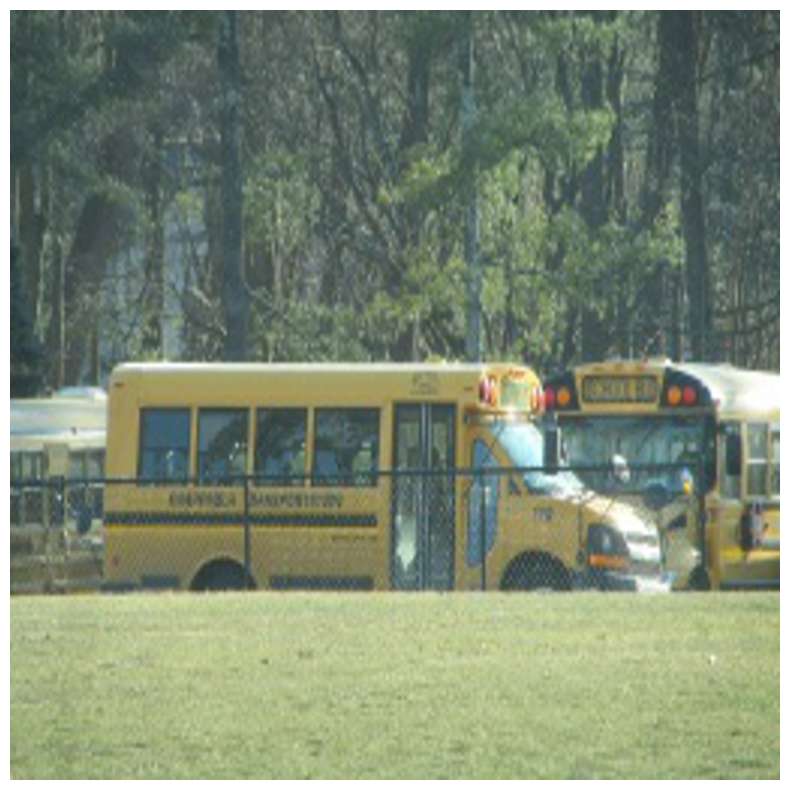

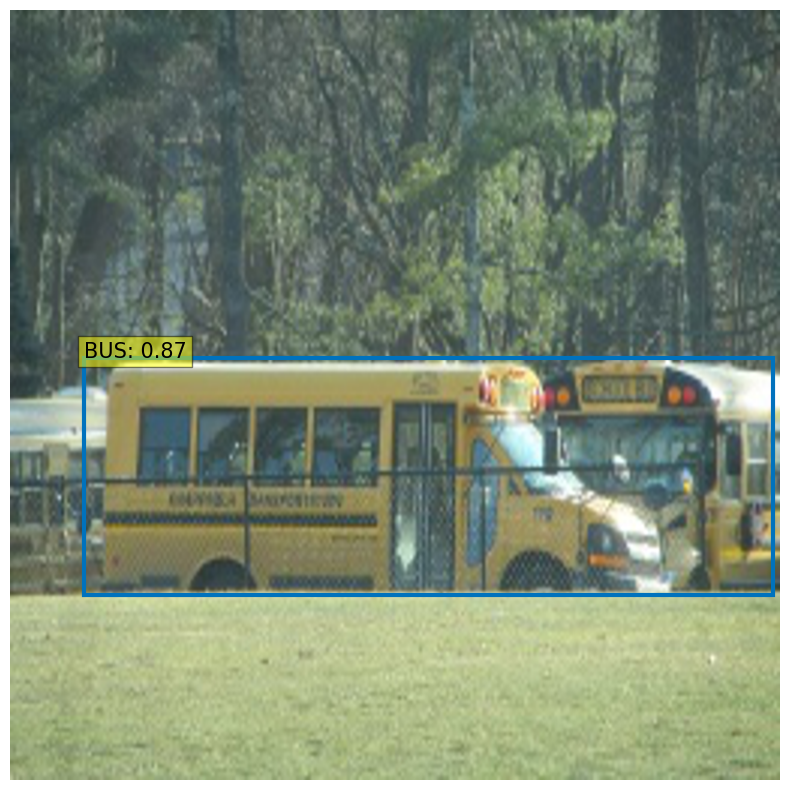

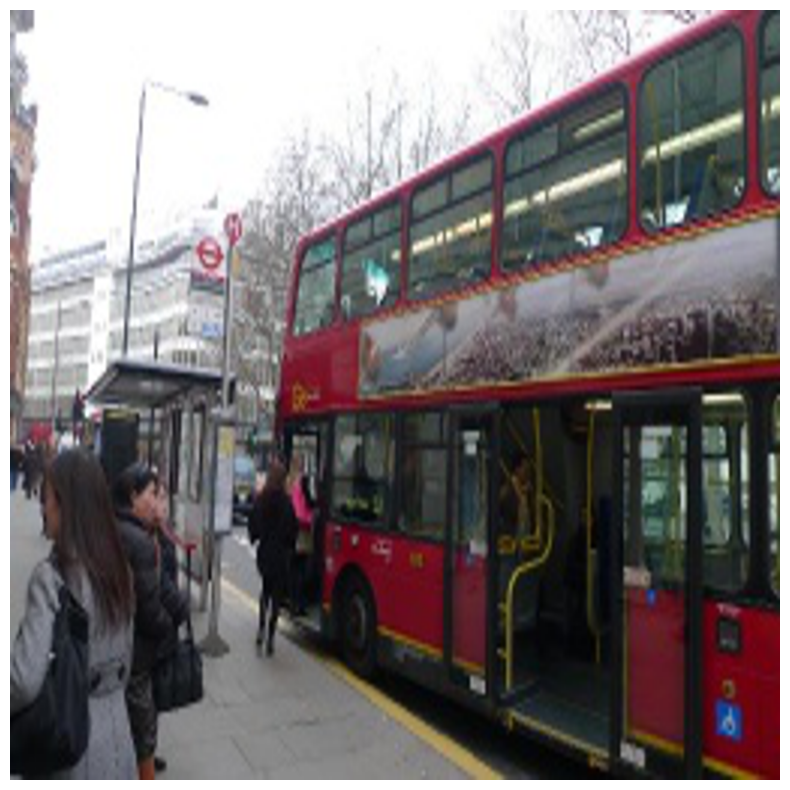

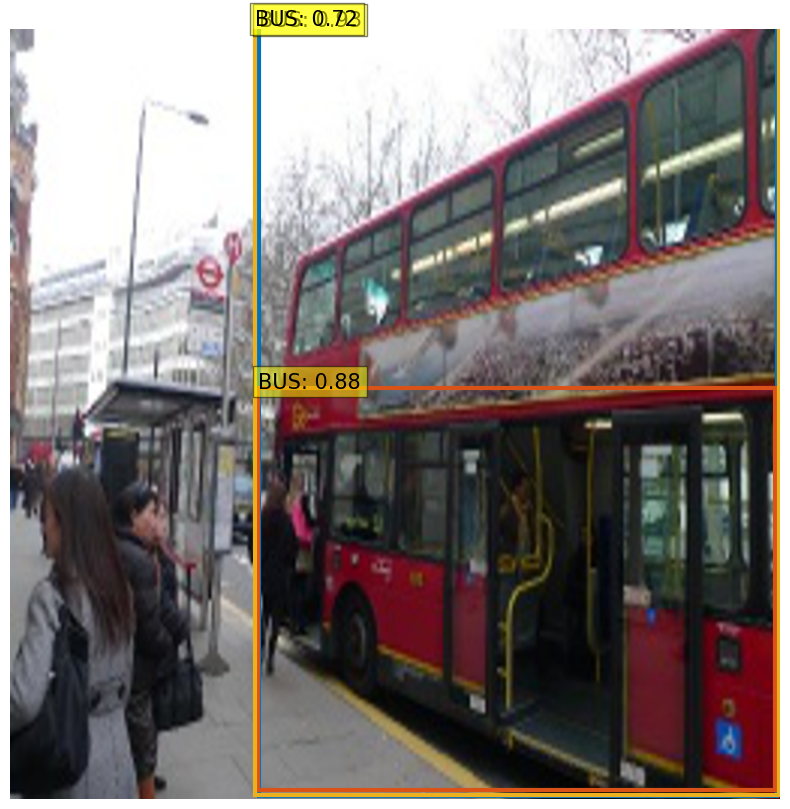

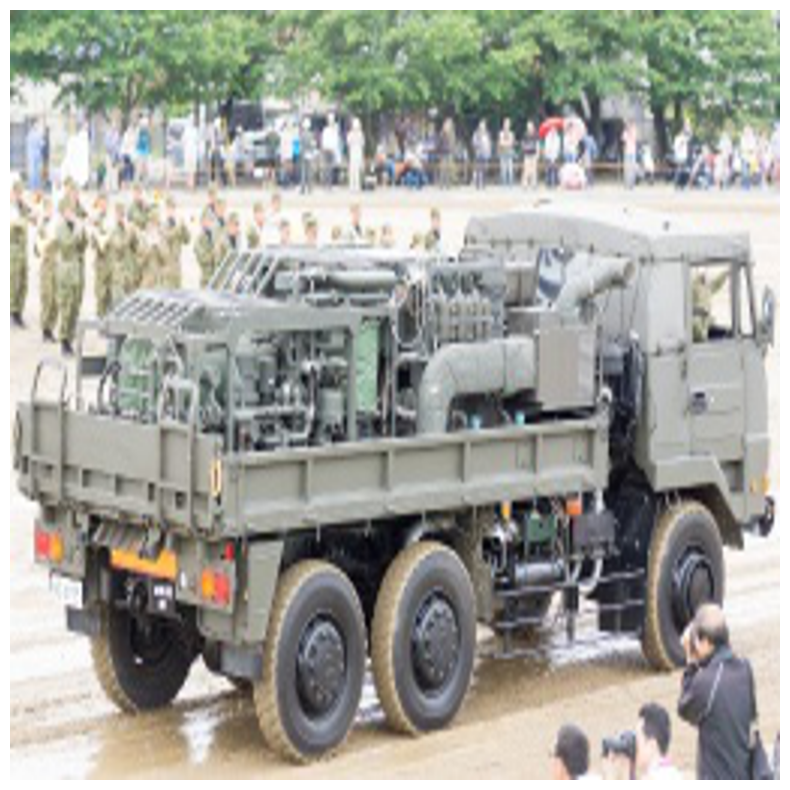

...

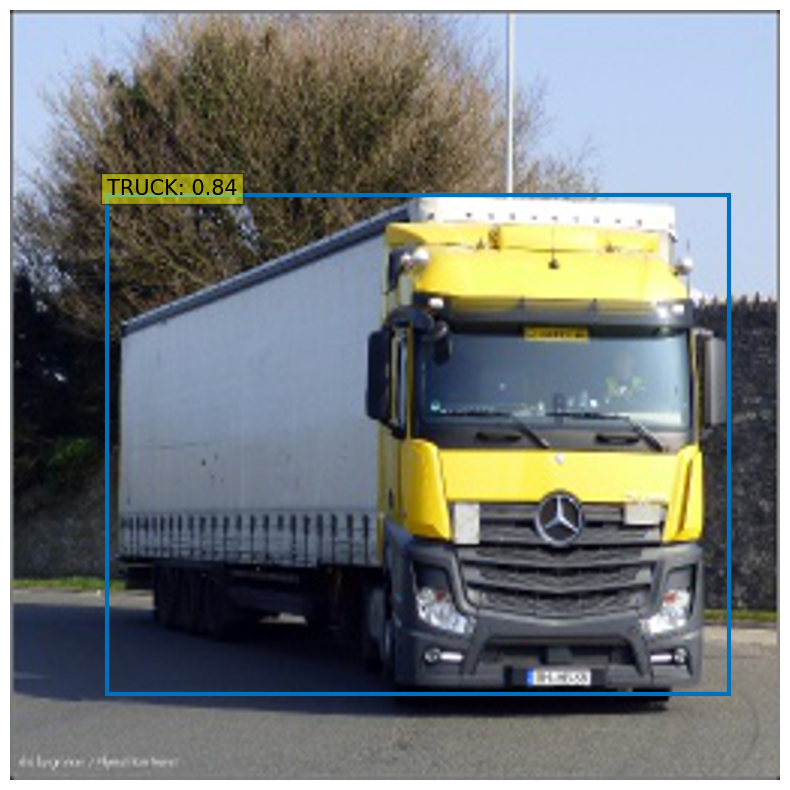

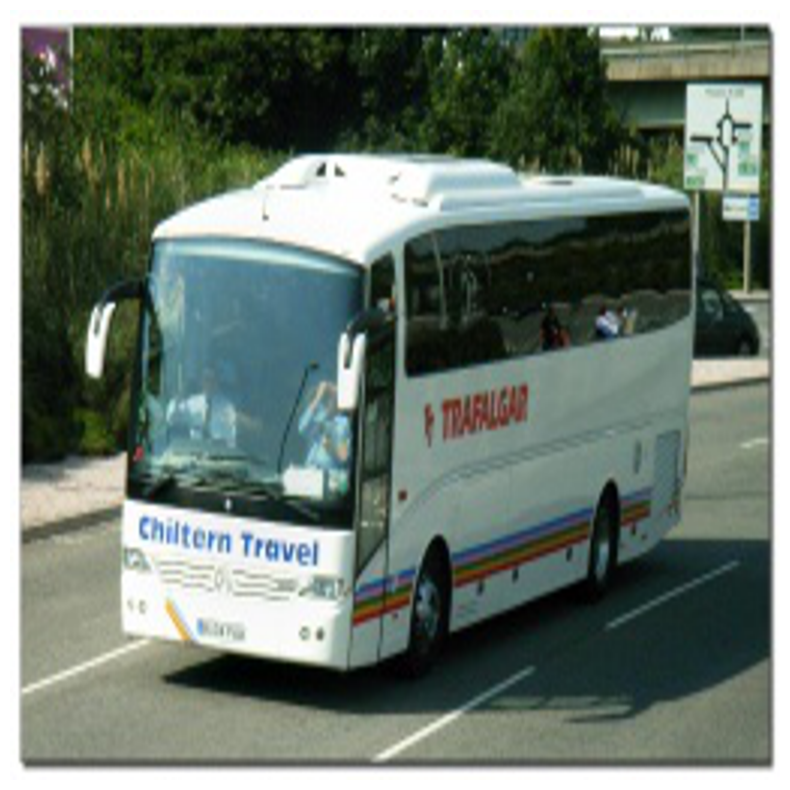

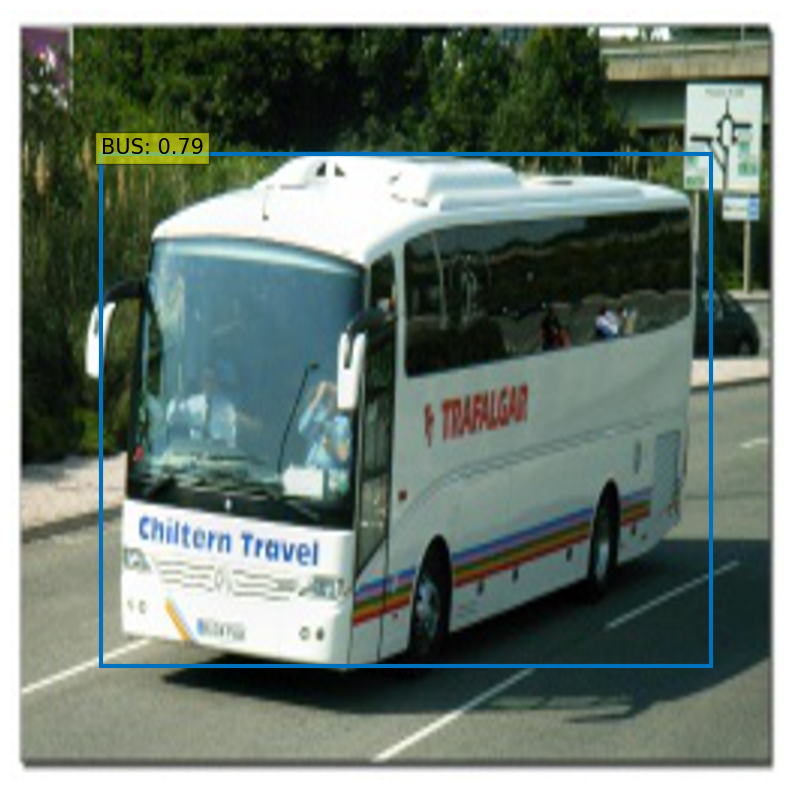

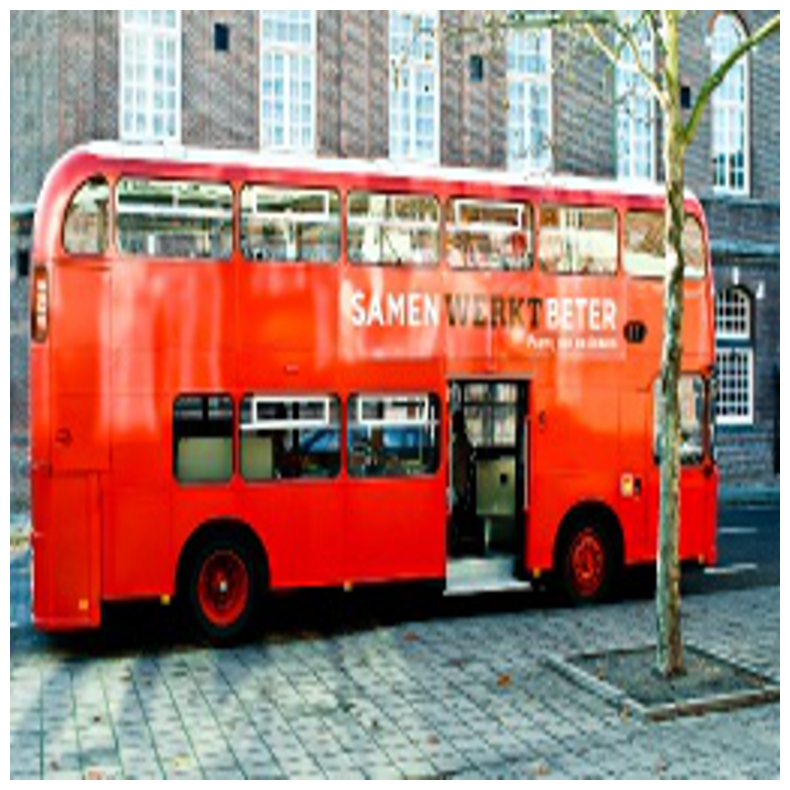

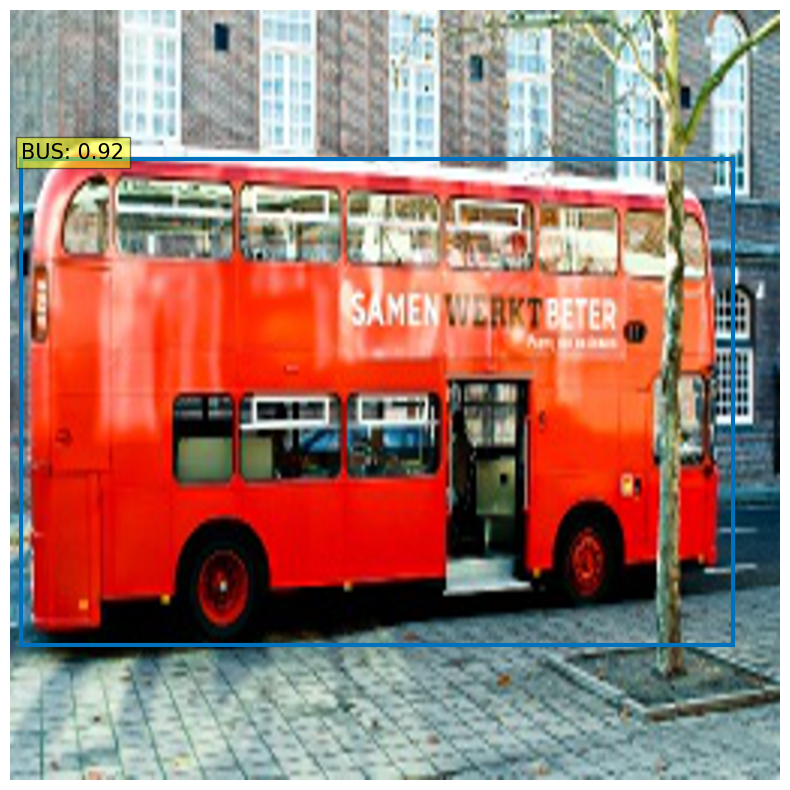

In [53]:
# Perform object detection on sample images
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for _ in range(10):
    # Choose a random image from the dataset
    image = Image.open(choose(Glob('../Data/open-images-bus-trucks/images/*'))).resize((800,800)).convert('RGB')
    # Detect objects in the image using the trained model
    scores, boxes = detect(image, model, transform)
    b_scores, b_boxes = detect(image, best_model, transform)
     # Visualize the results
    plot_results(image, scores, boxes)
    plot_results(image, b_scores, b_boxes)

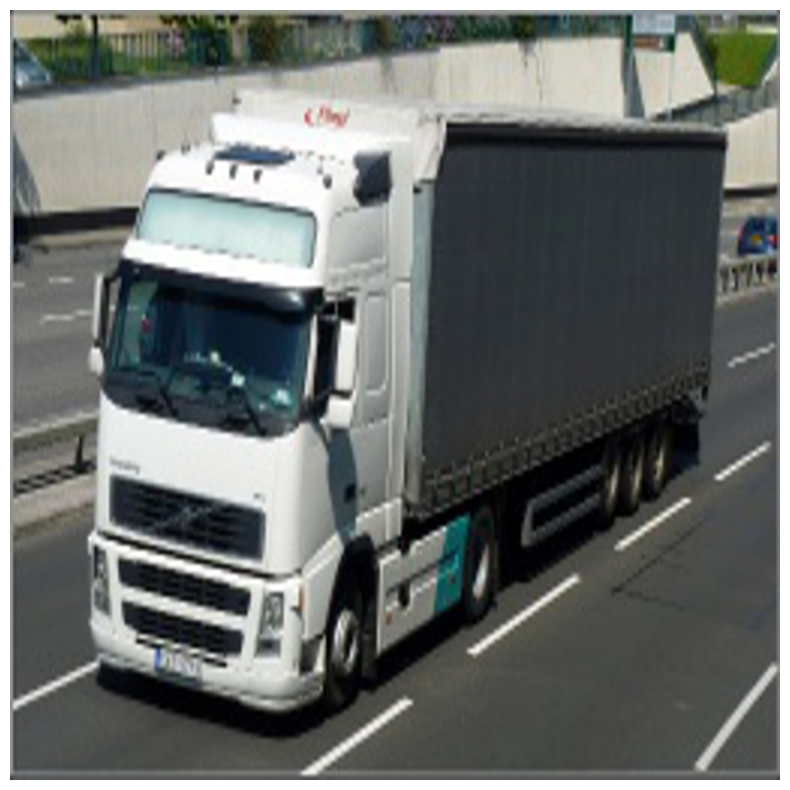

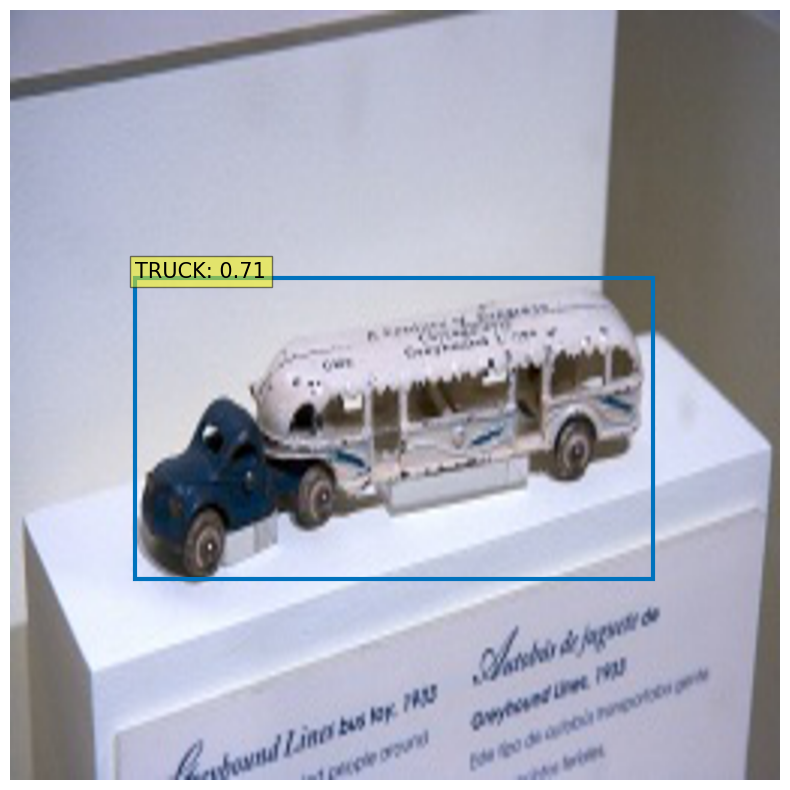

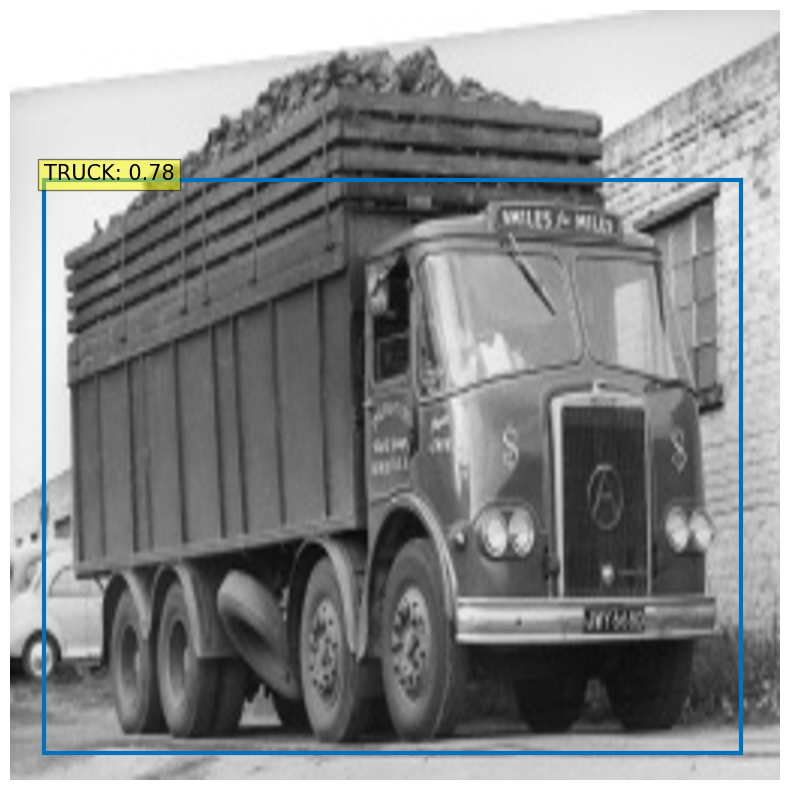

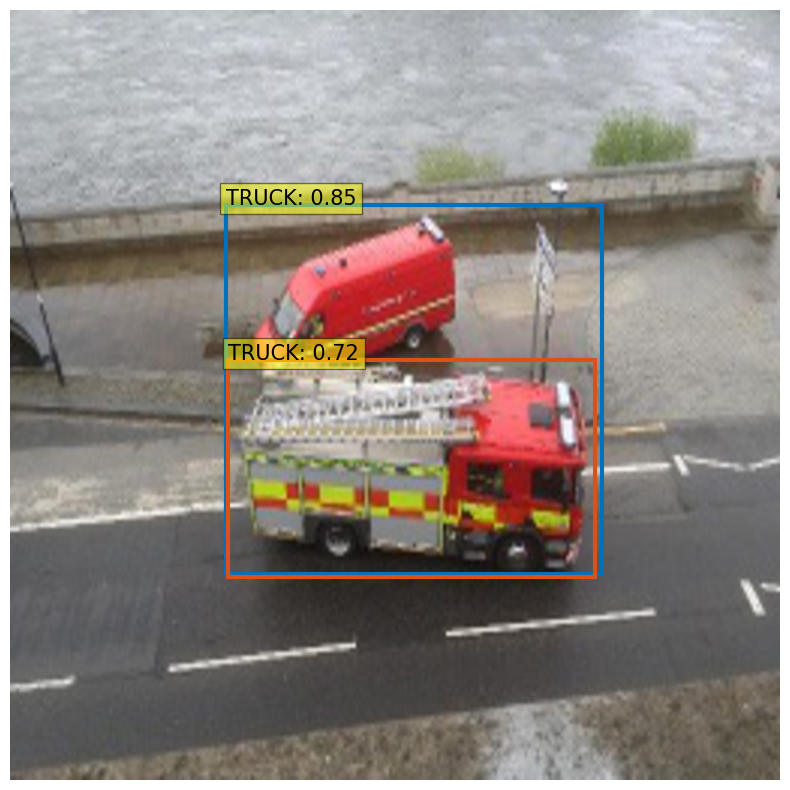

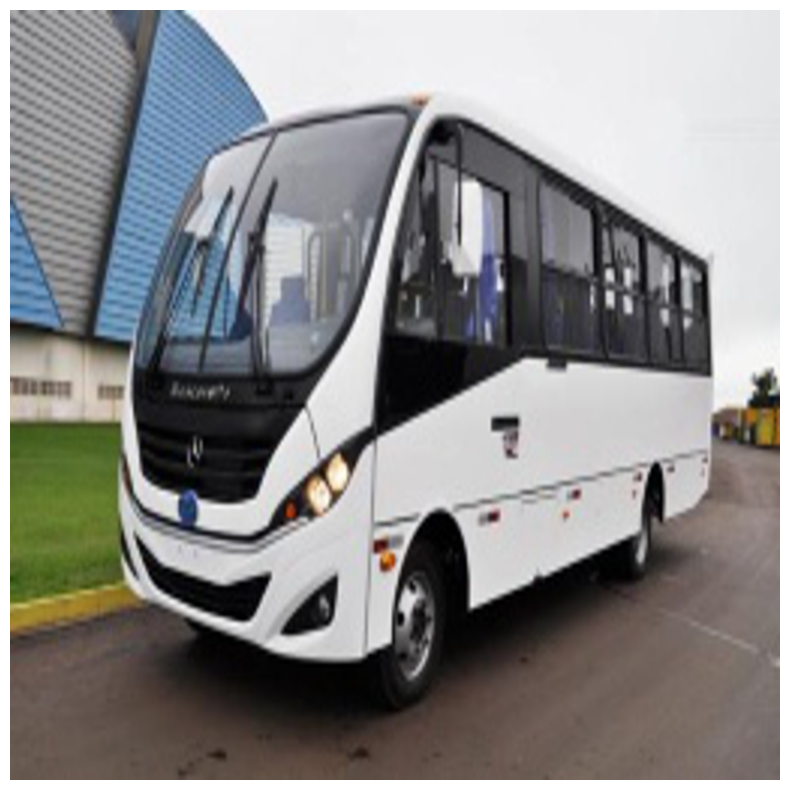

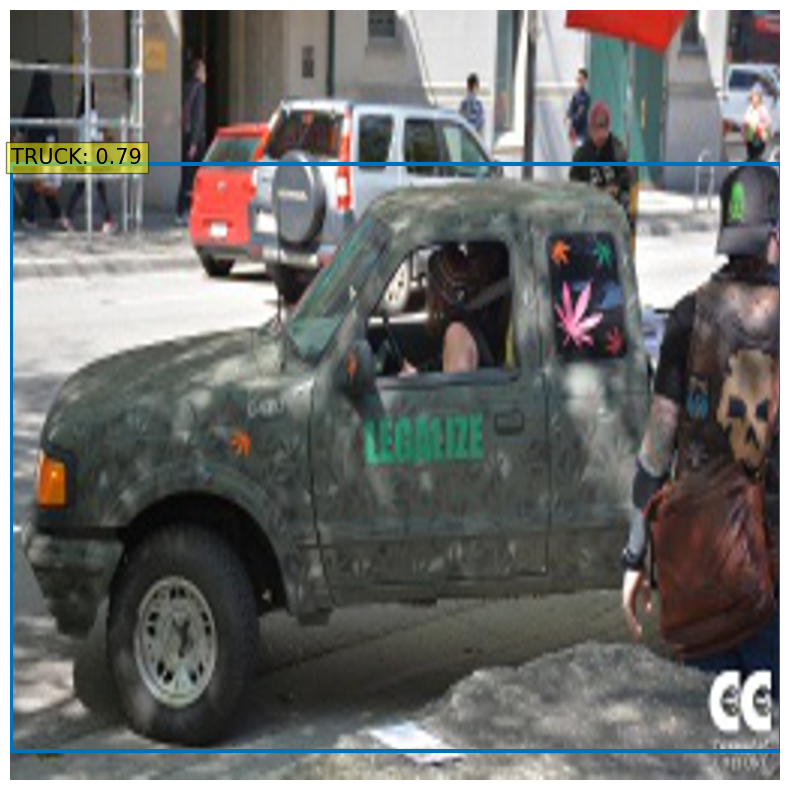

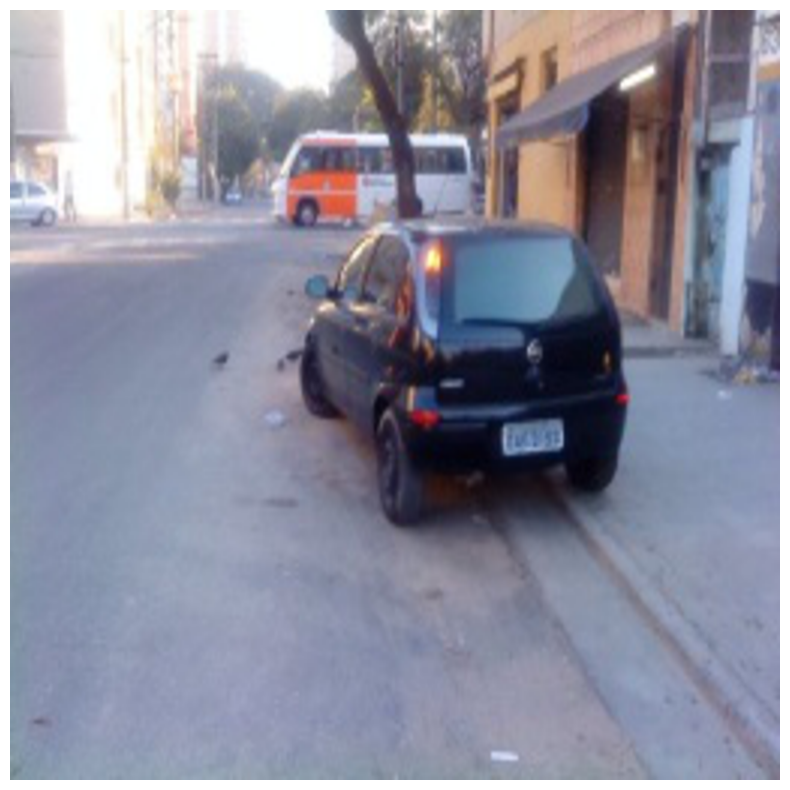

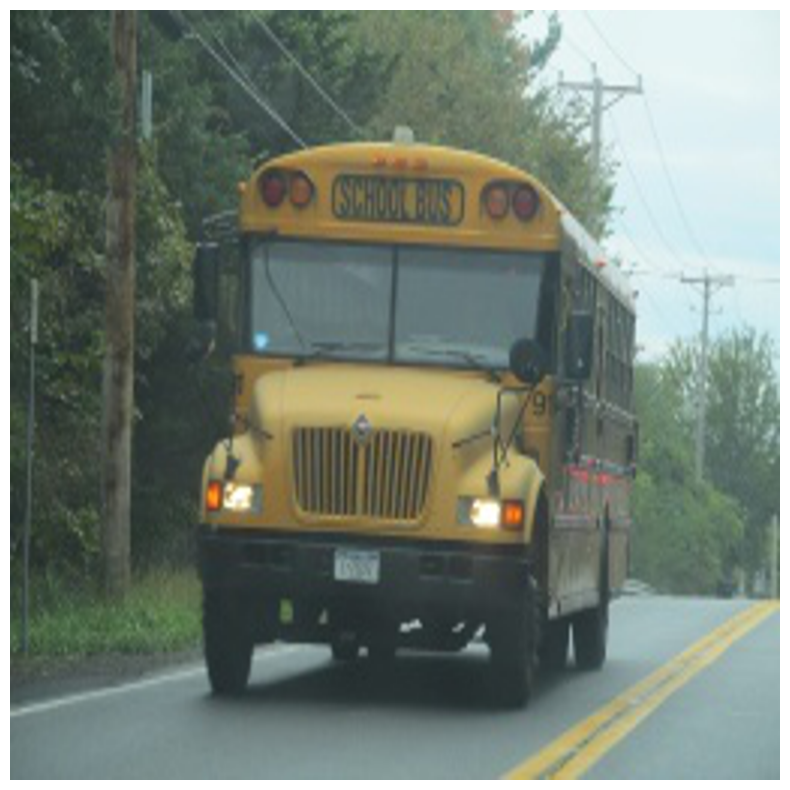

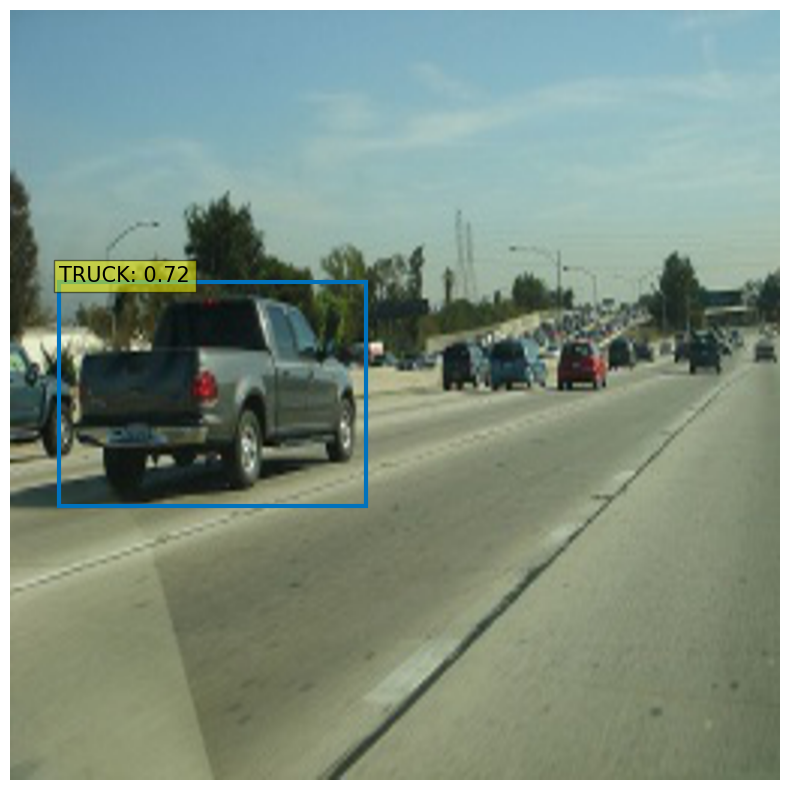

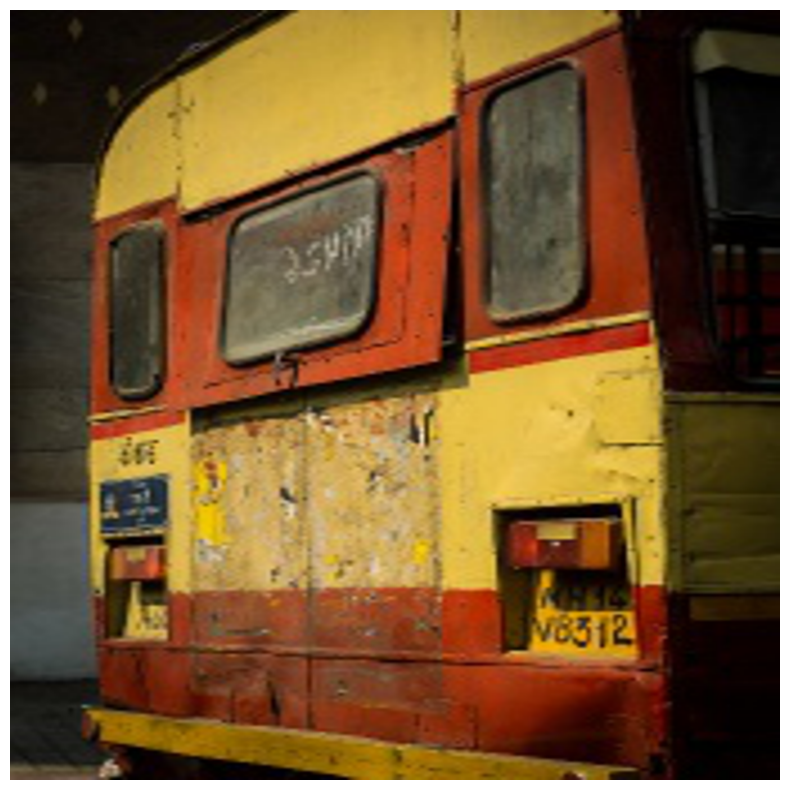

In [54]:
# Perform object detection on sample images
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for _ in range(10):
    # Choose a random image from the dataset
    image = Image.open(choose(Glob('../Data/open-images-bus-trucks/images/*'))).resize((800,800)).convert('RGB')
    # Detect objects in the image using the trained model
    scores, boxes = detect(image, best_model, transform)
     # Visualize the results
    plot_results(image, scores, boxes)

In [58]:
!python -m torch.distributed.launch --nproc_per_node=3 --use_env ../DETR_pruning/detr_prune_snip_synflow.py --batch_size 2 --no_aux_loss --eval --resume DETR_output_snip_0.5C/best_checkpoint.pth --coco_path ../Data/open-images-bus-trucks





*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
| distributed init (rank 1): env://
| distributed init (rank 0): env://
| distributed init (rank 2): env://
git:
  sha: d5f049aada650f1251264c0a44b02e76134c3cd3, status: has uncommited changes, branch: main

Namespace(aux_loss=False, backbone='resnet50', batch_size=2, bbox_loss_coef=5, clip_max_norm=0.1, coco_panoptic_path=None, coco_path='../Data/open-images-bus-trucks', compression='0.5', compression_schedule='exponential', dataset_file='coco', dec_layers=6, device='cuda', dice_loss_coef=1, dilation=False, dim_feedforward=2048, dist_backend='nccl', dist_url='env://', distributed=True, dropout=0.1, enc_layers=6, eos_coef=0.1, epochs=300, eval=True, frozen_weights=None, giou_loss_coef=2, gpu=0, hi

In [24]:
"""
Plotting utilities to visualize training logs.
"""
import torch
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from pathlib import Path, PurePath


def plot_logs(logs, fields=('class_error', 'loss_bbox_unscaled', 'mAP'), ewm_col=0, log_name='log.txt', output_dir=None):
    '''
    Function to plot specific fields from training log(s). Plots both training and test results.

    :: Inputs - logs = list containing Path objects, each pointing to individual dir with a log file
              - fields = which results to plot from each log file - plots both training and test for each field.
              - ewm_col = optional, which column to use as the exponential weighted smoothing of the plots
              - log_name = optional, name of log file if different than default 'log.txt'.

    :: Outputs - matplotlib plots of results in fields, color coded for each log file.
               - solid lines are training results, dashed lines are test results.

    '''
    func_name = "plot_utils.py::plot_logs"

    # Verify logs is a list of Paths (list[Paths]) or single Pathlib object Path,
    # convert single Path to list to avoid 'not iterable' error

    if not isinstance(logs, list):
        if isinstance(logs, PurePath):
            logs = [logs]
            print(f"{func_name} info: logs param expects a list argument, converted to list[Path].")
        else:
            raise ValueError(f"{func_name} - invalid argument for logs parameter.\n \
            Expect list[Path] or single Path obj, received {type(logs)}")

    # Quality checks - verify valid dir(s), that every item in list is Path object, and that log_name exists in each dir
    for i, dir in enumerate(logs):
        if not isinstance(dir, PurePath):
            raise ValueError(f"{func_name} - non-Path object in logs argument of {type(dir)}: \n{dir}")
        if not dir.exists():
            raise ValueError(f"{func_name} - invalid directory in logs argument:\n{dir}")
        # Verify log_name exists
        fn = Path(dir / log_name)
        if not fn.exists():
            print(f"-> missing {log_name}.  Have you gotten to Epoch 1 in training?")
            print(f"--> full path of missing log file: {fn}")
            return

    # Load log file(s) and plot
    dfs = [pd.read_json(Path(p) / log_name, lines=True) for p in logs]

    fig, axs = plt.subplots(ncols=len(fields), figsize=(16, 5))

    for df, color, dir in zip(dfs, sns.color_palette(n_colors=len(logs)), logs):
        for j, field in enumerate(fields):
            if field == 'mAP':
                coco_eval = pd.DataFrame(
                    np.stack(df.test_coco_eval_bbox.dropna().values)[:, 0]
                ).ewm(com=ewm_col).mean()
                axs[j].plot(coco_eval, c=color, label=f'{Path(dir).name} test_{field}', linestyle='--')
            else:
                # Ensure columns are numeric
                train_field = f'train_{field}'
                test_field = f'test_{field}'
                
                df[train_field] = pd.to_numeric(df[train_field], errors='coerce')
                df[test_field] = pd.to_numeric(df[test_field], errors='coerce')

                # Drop non-numeric columns
                df_numeric = df[[train_field, test_field]].dropna()

                df_numeric.interpolate().ewm(com=ewm_col).mean().plot(
                    y=[train_field, test_field],
                    ax=axs[j],
                    color=[color] * 2,
                    style=['-', '--'],  # Solid line for training, dashed line for test
                    label=[f'{Path(dir).name} {train_field}', f'{Path(dir).name} {test_field}']
                )
    for ax, field in zip(axs, fields):
        ax.legend()
        ax.set_title(field)

    if output_dir:
        fig.savefig(Path(output_dir) / "training_plots.png")


def plot_precision_recall(files, naming_scheme='iter'):
    if naming_scheme == 'exp_id':
        # name becomes exp_id
        names = [f.parts[-3] for f in files]
    elif naming_scheme == 'iter':
        names = [f.stem for f in files]
    else:
        raise ValueError(f'not supported {naming_scheme}')
    fig, axs = plt.subplots(ncols=2, figsize=(16, 5))
    for f, color, name in zip(files, sns.color_palette("Blues", n_colors=len(files)), names):
        data = torch.load(f)
        # precision is n_iou, n_points, n_cat, n_area, max_det
        precision = data['precision']
        recall = data['params'].recThrs
        scores = data['scores']
        # take precision for all classes, all areas and 100 detections
        precision = precision[0, :, :, 0, -1].mean(1)
        scores = scores[0, :, :, 0, -1].mean(1)
        prec = precision.mean()
        rec = data['recall'][0, :, 0, -1].mean()
        print(f'{naming_scheme} {name}: mAP@50={prec * 100: 05.1f}, ' +
              f'score={scores.mean():0.3f}, ' +
              f'f1={2 * prec * rec / (prec + rec + 1e-8):0.3f}'
              )
        axs[0].plot(recall, precision, c=color, label=name)
        axs[1].plot(recall, scores, c=color, label=name)

    axs[0].set_title('Precision / Recall')
    axs[0].legend()
    axs[1].set_title('Scores / Recall')
    axs[1].legend()
    return fig, axs


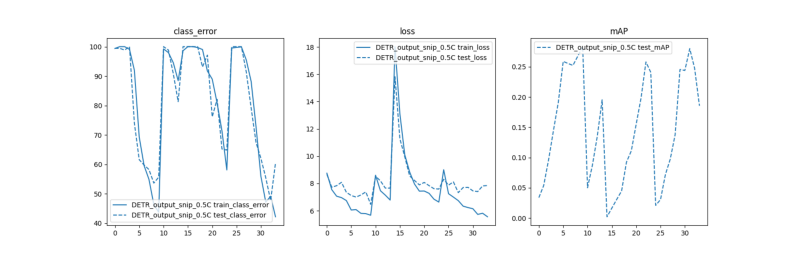

In [59]:
import matplotlib.pyplot as plt
from PIL import Image

def display_saved_plot(image_path):
    """
    Function to display a saved plot from a .png file.

    :: Inputs - image_path = path to the .png image file
    """
    # Open the image file
    img = Image.open(image_path)
    
    # Display the image
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.axis('off')  # Turn off axis
    plt.show()

# Example usage
display_saved_plot("DETR_output_snip_0.5C/training_plots.png")